## Cluster TMAs

**Samples:** 
- JP-TMA-1
- not JP-TMA-2 (only 2 ER+, and no survival data)

**Method**: 

- threshold and gate cell types

- marker expression in tumor/stroma

- leiden cluster on good biomarkers for celltypes


In [2]:
#load libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
import seaborn as sns
import scipy
import scanpy as sc
import matplotlib as mpl
from matplotlib import cm
mpl.rc('figure', max_open_warning = 0)
codedir = '/home/groups/graylab_share/OMERO.rdsStore/engje/Data/20200000/20200406_JP-TMAs'#os.getcwd()
import phenograph
os.chdir('/home/groups/graylab_share/OMERO.rdsStore/engje/Data')
from mplex_image import visualize as viz, process, preprocess, normalize, mics, mpimage
np.random.seed(126)

In [3]:
codedir

'/home/groups/graylab_share/OMERO.rdsStore/engje/Data/20200000/20200406_JP-TMAs'

In [4]:
#change to correct directory
datadir = f'/home/groups/graylab_share/OMERO.rdsStore/engje/Data/20200000/20200406_JP-TMAs/data'
s_date = '20211207'
os.chdir(codedir)
if not os.path.exists(s_date):
    os.mkdir(s_date)
%matplotlib inline

# Table of contents <a name="contents"></a>
1. [Load annotation](#loadold)
2. [load data](#cluster)
3. [load thresholds](#load)
  [gating](#gating)  [colocalization](#coloc)
4. [bg subtract](#leiden)
5. [single cell Umap](#l7)
6. [Leiden celltypes](#l8)
[annotate leiden celltypes](#lbar)
7. [Tissue means](#tissue)
8. [single variable survival](#surv)
9. [subtyping survival](#subt)

# Load annotation <a name="loadold"></a>

[contents](#contents)

In [5]:
df_cyc_a = pd.read_csv(f'{codedir}/20210403_JP-TMA1_Annotation+Clinical-Subtype.csv',index_col=0)
df_cyc_a.rename({'ClinicalSubtype':'ID'},axis=1,inplace=True)
#collapse Subtypes
d_replace = {'0':'other','?':'other', np.nan:'other'}
df_cyc_a.ID.replace(d_replace,inplace=True)
df_cyc_a.loc[df_cyc_a.index.str.contains('JP-TMA2-1'),'Accession'] = df_cyc_a.loc[df_cyc_a.index.str.contains('JP-TMA2-1'),'TMA_scene.1']
#add subtype and patient
d_cyc_sub = dict(zip(df_cyc_a.index.tolist(),df_cyc_a.ID.tolist()))
d_patient = dict(zip(df_cyc_a.index,df_cyc_a.Accession))


# JP-TMAs  <a name="cluster"></a>

JP-TMA-1 reextracted dec 2021 to include 10 additional cores (yay!)

filter markers, filter out edge cores (load manual data frame)


[contents](#contents)

In [5]:
os.chdir(datadir)
s_sample = 'features_JP-TMA1-1' #'20210309_JP-TMAs'
df_mi2 = pd.read_csv(f'{datadir}/{s_sample}_FilteredMeanIntensity.csv',index_col=0)
df_mi2.rename({'slide_scene':'slidescene'},axis=1,inplace=True)
df_xy = pd.read_csv(f'{datadir}/{s_sample}_CentroidXY.csv',index_col=0)
df_mi2.columns = [item.replace('_nucleipos','pos') for item in df_mi2.columns]

In [6]:
#load manual
s_man = '20211207_JP-TMA1_ManualPositive.csv'
df_man = pd.read_csv(s_man,index_col=0)

In [7]:
#this version has the cores cropped so the bordering cores are not included
len(df_man)

543692

In [9]:
len(df_mi2.loc[df_man.index])

543692

In [10]:
df_mi2 = df_mi2.loc[df_man.index]

In [11]:
df_mi2.columns

Index(['ER_nuclei25', 'AR_nuclei25', 'EGFR_cellmem25', 'HER2_cellmem25',
       'Ecad_cellmem25', 'CD44_nucadj2', 'Vim_nucadj2', 'BMP2_perinuc5',
       'CD20_perinuc5', 'CD3_perinuc5', 'CD31_perinuc5', 'CD4_perinuc5',
       'CD44_perinuc5', 'CD45_perinuc5', 'CD68_perinuc5', 'CD8_perinuc5',
       'ColI_perinuc5', 'ColIV_perinuc5', 'CoxIV_perinuc5', 'EGFR_perinuc5',
       'Glut1_perinuc5', 'PD1_perinuc5', 'PDGFRa_perinuc5', 'PDPN_perinuc5',
       'R1c2_perinuc5', 'R5Qc2_perinuc5', 'R5Qc3_perinuc5', 'R5Qc4_perinuc5',
       'R5Qc5_perinuc5', 'Vim_perinuc5', 'aSMA_perinuc5', 'pAKT_perinuc5',
       'pS6RP_perinuc5', 'CK14_cytoplasm', 'CK17_cytoplasm', 'CK19_cytoplasm',
       'CK5_cytoplasm', 'CK7_cytoplasm', 'CK8_cytoplasm', 'Ecad_cytoplasm',
       'HER2_cytoplasm', 'AR_nuclei', 'DAPI1_nuclei', 'DAPI10_nuclei',
       'DAPI11_nuclei', 'DAPI12_nuclei', 'DAPI2_nuclei', 'DAPI3_nuclei',
       'DAPI4_nuclei', 'DAPI5_nuclei', 'DAPI5Q_nuclei', 'DAPI6_nuclei',
       'DAPI7_nuclei', 'DAPI8

In [12]:

ls_drop = ['ER_nuclei', 'AR_nuclei25',  'HER2_cytoplasm', 'Ecad_cellmem25','EGFR_cellmem25', 'CD44_nucadj2', 'Vim_nucadj2',
           'R1c2_perinuc5', 'R5Qc2_perinuc5', 'R5Qc3_perinuc5', 'R5Qc4_perinuc5',
       'R5Qc5_perinuc5'] #'EGFR_cytoplasm' not in it
#synchronize with 20201017_JP-TMAs_cellpose_OutputPositive.iynb - just HER2 and EGFR cell mem 25
ls_drop = ['CD44_nucadj2','AR_nuclei25','EGFR_perinuc5','ER_nuclei25','HER2_cytoplasm','Vim_nucadj2',
          'Ecad_cellmem25','R1c2_perinuc5', 'R5Qc2_perinuc5', 'R5Qc3_perinuc5', 'R5Qc4_perinuc5','R5Qc5_perinuc5']
df_mi2 = df_mi2.drop(ls_drop,axis=1)
#(df_mi2.loc[:,'R1c2_nuclei'] > df_mi2.loc[:,'R1c2_perinuc5']).sum()/len(df_mi2)
# greater nuclei R1 c2 = 65%, R5Q c2 = 70%, c3 = 79%, c4 = 81%, c5 = 70%


In [13]:

#shorten and check
df_mi2.columns = [item.split('_')[0] for item in df_mi2.columns]
print(len(df_mi2.columns))
df_mi2.columns[df_mi2.columns.duplicated()]


79


Index([], dtype='object')

In [14]:
#thresholds new (with added cores)
ls_sample = ['JP-TMA1-1'] #, 'JP-TMA2-1','JE-TMA-42'
df_thresh = pd.DataFrame()
for s_sample in ls_sample:
    df = pd.read_csv(f'{codedir}/data/thresh_JE_{s_sample}.csv',index_col=0)
    df['slide'] = s_sample
    df_thresh =df_thresh.append(df)
se_test = df_thresh.loc['global'].dropna() #drop 'PDGFRa', 'ColI'

In [15]:
#thresholds old
ls_sample = ['JP-TMA1-1'] #, 'JP-TMA2-1','JE-TMA-42'
df_thresh = pd.DataFrame()
for s_sample in ls_sample:
    df = pd.read_csv(f'{codedir}/data/thresh_JE_{s_sample}_old.csv',index_col=0)
    df['slide'] = s_sample
    df_thresh =df_thresh.append(df)
se_test_old = df_thresh.loc['global'].dropna() #drop 'PDGFRa', 'ColI'

In [16]:
(se_test.loc[se_test_old.index] != se_test_old).sum()

0

In [19]:
'''
#43 markers (plus DAPI, area, eccentricity) not thresholded = 'ColI', 'cPARP', 'gH2AX', 'HIF1a', 'PDGFRa', 'R1c2', 'R5Qc2', 'R5Qc3', 'R5Qc4', 'R5Qc5',
print(len(set(df_thresh.loc['global'].dropna().index).intersection(set(df_mi2.columns))))
#ls_marker = sorted(set(df_mi.columns).intersection(set(df_mi2.columns)))
ls_pos = ['AR', 'BMP2', 'CD20', 'CD3','CD31', 'CD4', 'CD44', 'CD45', 'CD68', 'CD8', 'CK14', 'CK17', 'CK19', 'CK5', 'CK7',
 'CK8', 'ColIV', 'CoxIV', 'EGFR', 'ER', 'Ecad', 'FoxP3', 'GRNZB', 'Glut1', 'H3K27', 'H3K4', 'HER2', 'Ki67', 'LamAC', 'LamB1',
 'LamB2', 'PCNA', 'PD1', 'PDPN', 'PgR', 'Vim', 'aSMA', 'pAKT', 'pERK', 'pHH3', 'pRB', 'pS6RP',
          'R1c2','R5Qc2','DAPI2' #add three non thresholded markers
         ] #42 markers thresholded, 
'''

"\n#43 markers (plus DAPI, area, eccentricity) not thresholded = 'ColI', 'cPARP', 'gH2AX', 'HIF1a', 'PDGFRa', 'R1c2', 'R5Qc2', 'R5Qc3', 'R5Qc4', 'R5Qc5',\nprint(len(set(df_thresh.loc['global'].dropna().index).intersection(set(df_mi2.columns))))\n#ls_marker = sorted(set(df_mi.columns).intersection(set(df_mi2.columns)))\nls_pos = ['AR', 'BMP2', 'CD20', 'CD3','CD31', 'CD4', 'CD44', 'CD45', 'CD68', 'CD8', 'CK14', 'CK17', 'CK19', 'CK5', 'CK7',\n 'CK8', 'ColIV', 'CoxIV', 'EGFR', 'ER', 'Ecad', 'FoxP3', 'GRNZB', 'Glut1', 'H3K27', 'H3K4', 'HER2', 'Ki67', 'LamAC', 'LamB1',\n 'LamB2', 'PCNA', 'PD1', 'PDPN', 'PgR', 'Vim', 'aSMA', 'pAKT', 'pERK', 'pHH3', 'pRB', 'pS6RP',\n          'R1c2','R5Qc2','DAPI2' #add three non thresholded markers\n         ] #42 markers thresholded, \n"

In [18]:
df_mi2 = df_mi2.merge(df_xy,left_index=True, right_index=True)
df_mi2.rename({'nuclei_area':'area','nuclei_eccentricity':'eccentricity'},axis=1,inplace=True)

In [21]:
#s_out = f'{codedir}/data/{s_date}_JP-TMAs_FilteredMeanIntensity.csv'
s_out = f'{codedir}/data/20211207_JP-TMA1_FilteredMeanIntensity.csv'
if not os.path.exists(s_out):
    print('saving csv')
    df_mi2.to_csv(s_out)

saving csv


In [22]:
df_mi2

,EGFR,HER2,BMP2,CD20,CD3,CD31,CD4,CD44,CD45,CD68,...,DAPI8pos,DAPI9pos,DAPI10pos,DAPI11pos,DAPI12pos,area,DAPI_Y,DAPI_X,eccentricity,slide_scene
JP-TMA1-1_scene001_cell1,0.000000,136.932432,1392.175610,1360.351220,1072.536585,99.365854,60.653659,468.073171,1125.019512,5.141463,...,True,True,True,False,False,68,415.044118,4564.044118,0.220400,JP-TMA1-1_scene001
JP-TMA1-1_scene001_cell2,0.000000,393.492611,1359.814645,1341.002288,0.000000,4.750572,71.713959,478.752860,1115.954233,5.290618,...,False,False,False,False,False,362,678.558011,1521.364641,0.528040,JP-TMA1-1_scene001
JP-TMA1-1_scene001_cell3,0.000000,298.531915,1359.304511,1349.011278,1086.548872,89.530075,60.251880,469.823308,1106.323308,4.093985,...,False,False,False,False,False,121,823.520661,4337.900826,0.770396,JP-TMA1-1_scene001
JP-TMA1-1_scene001_cell4,0.000000,307.048780,1380.063898,1362.015974,1099.319489,91.271565,64.856230,475.527157,1137.038339,3.450479,...,False,False,False,False,False,185,876.967568,4090.281081,0.801923,JP-TMA1-1_scene001
JP-TMA1-1_scene001_cell5,0.000000,340.888889,1440.801325,1422.682119,1125.231788,84.788079,63.218543,630.701987,1180.516556,2.589404,...,False,False,False,False,False,27,922.777778,3905.185185,0.705053,JP-TMA1-1_scene001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JP-TMA1-1_scene131_cell2372,432.364583,226.693878,1488.116541,1411.684211,1097.120301,212.421053,94.428571,514.992481,440.462406,40.015038,...,True,True,True,True,True,128,5593.007812,2627.085938,0.718244,JP-TMA1-1_scene131
JP-TMA1-1_scene131_cell2373,318.500000,204.719101,1446.007843,1413.952941,1094.137255,197.231373,105.913725,502.007843,0.000000,0.000000,...,True,True,True,True,True,108,5603.675926,2678.046296,0.799115,JP-TMA1-1_scene131
JP-TMA1-1_scene131_cell2374,328.990909,207.620370,1478.256849,1400.880137,1093.414384,222.205479,110.602740,535.215753,0.000000,0.000000,...,True,True,True,True,True,144,5612.263889,2594.159722,0.868310,JP-TMA1-1_scene131
JP-TMA1-1_scene131_cell2375,331.131313,210.431579,1479.723881,1411.145522,1106.660448,217.324627,114.029851,559.033582,0.000000,0.000000,...,True,True,True,True,True,121,5621.214876,2509.900826,0.791243,JP-TMA1-1_scene131


# thresholding <a name="load"></a>

load thresholds, apply to get positive/negative

filter out edge cores

[contents](#contents)

In [186]:
from mplex_image import visualize as viz

s_sample = 'JP-TMA1-1'
d_combos = {'Tumor':{'AR', 'EGFR', 'ER', 'Ecad','HER2', 'PgR'},
            'Immune':{'CD20', 'CD3', 'CD4', 'CD44', 'CD45', 'CD68', 'CD8','FoxP3', 'GRNZB','PD1'},
            'Differentiation':{'CK14', 'CK17', 'CK19', 'CK5', 'CK7', 'CK8'},
            'Stroma':{ 'CD31','PDPN',  'Vim', 'aSMA','ColIV'},
            'Nuclear': {'LamAC', 'LamB1','LamB2','H3K27', 'H3K4','Ki67','PCNA'},
            'Signal':{ 'CoxIV',   'Glut1',  'pAKT', 'pERK', 'pHH3', 'pRB', 'pS6RP','BMP2'},
            'DAPI':{'DAPI1','DAPI6','DAPI10','DAPI12'}
            }
#make thresh csv's
df_man = viz.new_thresh_csv(df_mi2,d_combos)
if not os.path.exists(f'thresh_JE_{s_sample}.csv'):
    print('saving new csv')
    df_man.to_csv(f'thresh_JE_{s_sample}.csv',header=True)
#load manual thresholds
df_thresh = viz.load_thresh_csv(s_sample)


In [187]:
for s_scene in sorted(set(df_mi2.slide_scene)):
    print(f"\'{s_scene}\':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),")
    #break

'JP-TMA1-1_scene001':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene002':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene003':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene004':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene005':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene006':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene007':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene008':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene009':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 50

In [188]:
#lots of filtering - now done on data

d_filter = {
#'JP-TMA1-1_scene001':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene002':((df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene003':((df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene004':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene005':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene006':((df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene007':((df_xy.DAPI_Y < 1000)),
'JP-TMA1-1_scene008':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene009':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene010':((df_xy.DAPI_Y < 1000) |(df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene011':( (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene013':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene014':( (df_xy.DAPI_X > 5000)),
'JP-TMA1-1_scene015':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene016':( (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene017':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene018':( (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene019':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene020':( (df_xy.DAPI_X < 500) | (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene021':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 1000) ),
'JP-TMA1-1_scene022':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene023':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene024':( (df_xy.DAPI_X < 800) | (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene025':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene026':( (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene027':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene028':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene029':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene030':( (df_xy.DAPI_X < 1000) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene031':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene032':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene033':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene034':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene035':( (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene036':((df_xy.DAPI_X < 1000) ),
'JP-TMA1-1_scene037':((df_xy.DAPI_Y < 1000) |(df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene038':( (df_xy.DAPI_X < 500) |  (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene039':( (df_xy.DAPI_X < 1000) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene040':( (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene042':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene041':((df_xy.DAPI_Y < 1200) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene043':((df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene044':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 5000)| (df_xy.DAPI_Y > 5500)),
#'JP-TMA1-1_scene045':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene046':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene047':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene048':((df_xy.DAPI_Y > 4500)),
#'JP-TMA1-1_scene049':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene050':((df_xy.DAPI_Y < 1500) ),
'JP-TMA1-1_scene051':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene052':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene053':((df_xy.DAPI_X < 500) |(df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene054':((df_xy.DAPI_Y < 1500) |  (df_xy.DAPI_Y > 6500)),
#'JP-TMA1-1_scene055':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene056':( (df_xy.DAPI_X > 4500)),
#'JP-TMA1-1_scene057':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene058':( (df_xy.DAPI_X < 500) ),
'JP-TMA1-1_scene059':((df_xy.DAPI_Y < 800) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene060':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene061':((df_xy.DAPI_Y < 900) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene062':((df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene063':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene064':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene065':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) ),
'JP-TMA1-1_scene066':( (df_xy.DAPI_X < 800) |  (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene067':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene068':( (df_xy.DAPI_X > 4000)),
'JP-TMA1-1_scene069':( (df_xy.DAPI_X > 4000)),
'JP-TMA1-1_scene070':((df_xy.DAPI_Y < 500) | (df_xy.DAPI_X < 500) ),
'JP-TMA1-1_scene071':( (df_xy.DAPI_X < 1000) |  (df_xy.DAPI_Y > 4000)),
#'JP-TMA1-1_scene072':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene073':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene074':((df_xy.DAPI_X > 5000)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene075':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene076':( (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene077':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene078':( (df_xy.DAPI_X < 1000) | (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene079':( (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene080':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene081':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene082':( (df_xy.DAPI_X < 700) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene083':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 1000) ),
#'JP-TMA1-1_scene084':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene085':((df_xy.DAPI_Y < 1000)),
'JP-TMA1-1_scene086':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene087':((df_xy.DAPI_Y < 500) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 5000)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene088':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene089':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene090':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene091':((df_xy.DAPI_Y < 1000) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene092':( (df_xy.DAPI_X < 1000) |  (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene093':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene094':((df_xy.DAPI_Y < 1500)  | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene095':((df_xy.DAPI_Y < 1500)),
'JP-TMA1-1_scene096':((df_xy.DAPI_Y > 3500)),
'JP-TMA1-1_scene097':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene098':((df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene099':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene100':((df_xy.DAPI_Y < 1000) |  (df_xy.DAPI_X > 5600)),
'JP-TMA1-1_scene101':((df_xy.DAPI_Y > 5000) | (df_xy.DAPI_X > 4000)),
'JP-TMA1-1_scene102':( (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 5000)| (df_xy.DAPI_Y > 5000)), #??
'JP-TMA1-1_scene103':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene104':( (df_xy.DAPI_X < 300) | (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene105':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene106':( (df_xy.DAPI_X < 500) |  (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene107':( (df_xy.DAPI_X > 4500)),
'JP-TMA1-1_scene108':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene109':( (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene110':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) |  (df_xy.DAPI_Y > 5000)),
    
'JP-TMA1-1_scene111':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene112':( (df_xy.DAPI_X < 500) |  (df_xy.DAPI_Y > 4500)),
'JP-TMA1-1_scene113':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene114':((df_xy.DAPI_Y < 1500)),
'JP-TMA1-1_scene115':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X > 4500) ),
'JP-TMA1-1_scene116':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene117':((df_xy.DAPI_X < 500)),
'JP-TMA1-1_scene118':( (df_xy.DAPI_X < 1000) | (df_xy.DAPI_X > 6000)| (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene119':( (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene120':((df_xy.DAPI_X > 5000)| (df_xy.DAPI_Y > 5000)),
#'JP-TMA1-1_scene121':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene122':((df_xy.DAPI_Y < 800) | (df_xy.DAPI_Y > 4000)),
'JP-TMA1-1_scene123':((df_xy.DAPI_Y < 1000)),
#'JP-TMA1-1_scene124':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 500) | (df_xy.DAPI_X > 4500)| (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene125':( (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene126':( (df_xy.DAPI_X < 1000) | (df_xy.DAPI_X > 5000)),
'JP-TMA1-1_scene127':((df_xy.DAPI_Y < 1000) ),
'JP-TMA1-1_scene128':((df_xy.DAPI_Y < 1000) | (df_xy.DAPI_X < 1000)),
'JP-TMA1-1_scene129':((df_xy.DAPI_X < 1000) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene130':((df_xy.DAPI_Y < 600) | (df_xy.DAPI_X < 1000) |  (df_xy.DAPI_Y > 5000)),
'JP-TMA1-1_scene131':( (df_xy.DAPI_Y > 6000)),}
ls_filter_all = []
for s_scene, filtercon in d_filter.items():
    ls_filter = df_xy[(df_xy.slide_scene==s_scene) & filtercon].index.tolist()
    ls_filter_all = ls_filter_all + ls_filter

In [189]:
#threshold
d_thresh_record,df_pos = viz.threshold_postive(df_thresh,df_mi2.loc[(~df_mi2.index.isin(ls_filter_all)),(df_mi2.dtypes=='float64') | (df_mi2.columns=='slide_scene')])

Did not threshold {'DAPI7', 'R5Qc2', 'PDGFRa', 'ColI', 'gH2AX', 'R5Qc3', 'DAPI4', 'DAPI11', 'DAPI2', 'R1c2', 'R5Qc5', 'R5Qc4', 'eccentricity', 'HIF1a', 'DAPI', 'DAPI5Q', 'DAPI3', 'DAPI9', 'DAPI8', 'cPARP'}


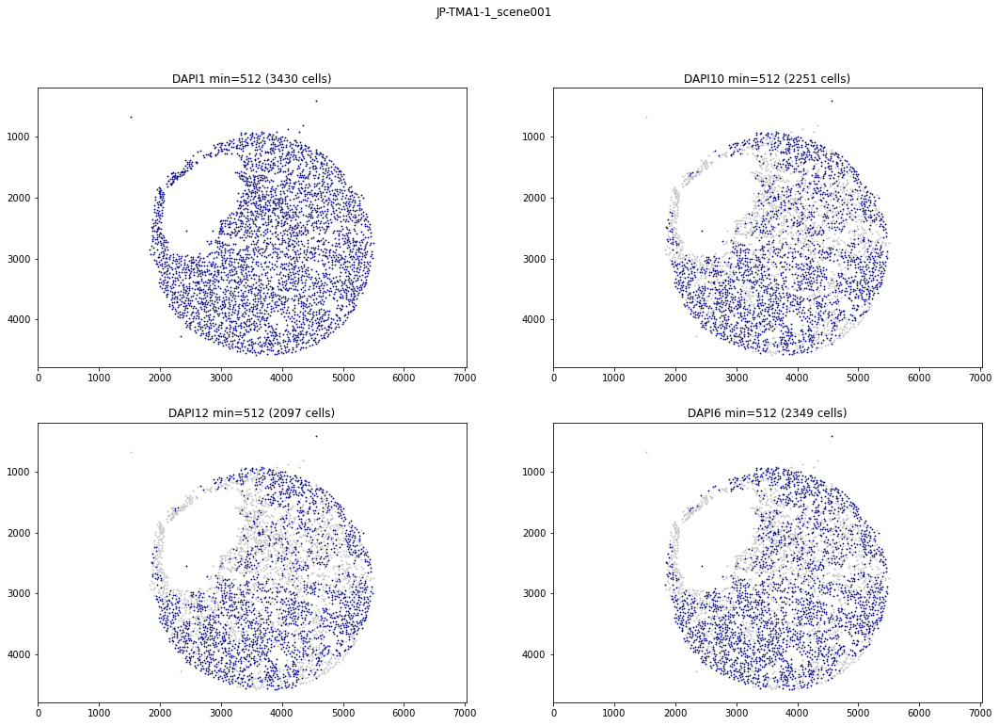

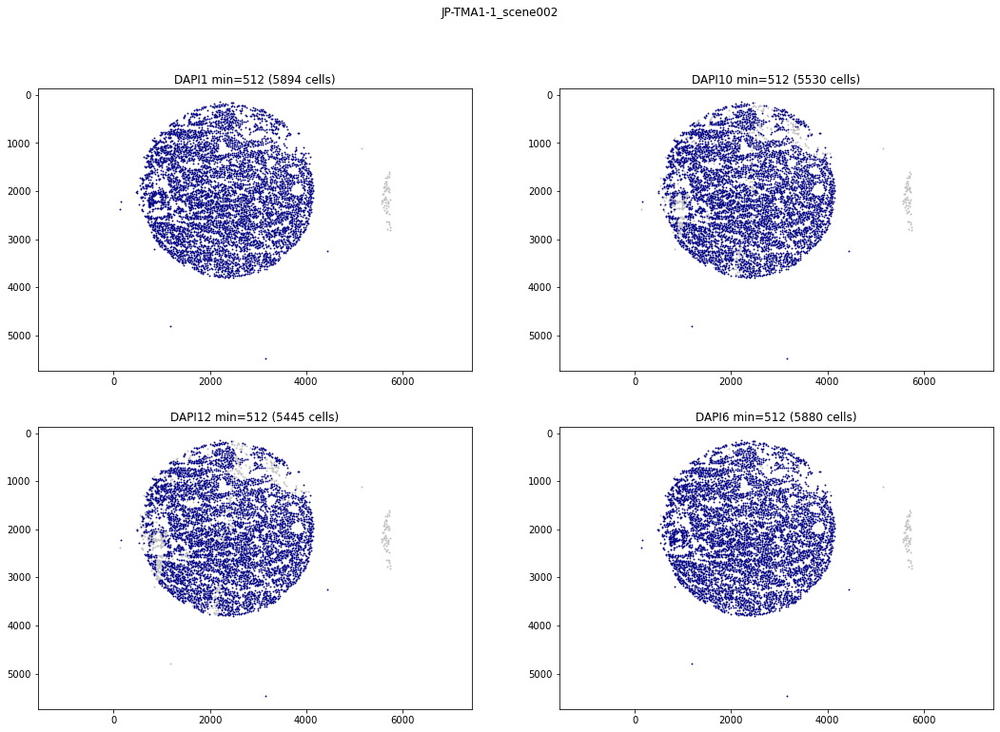

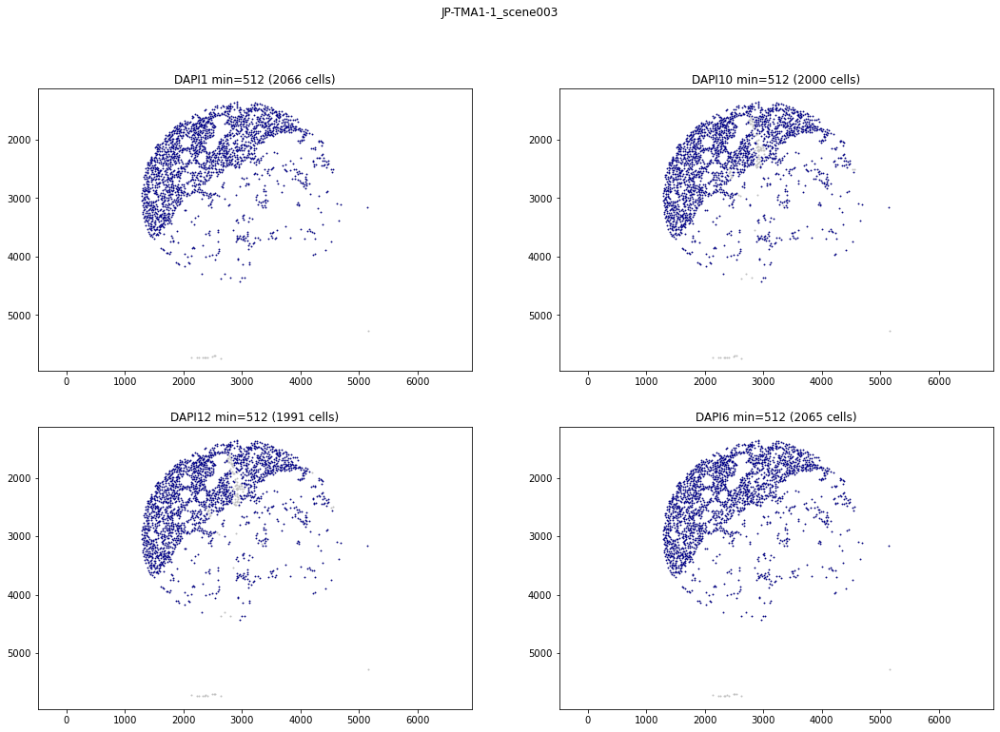

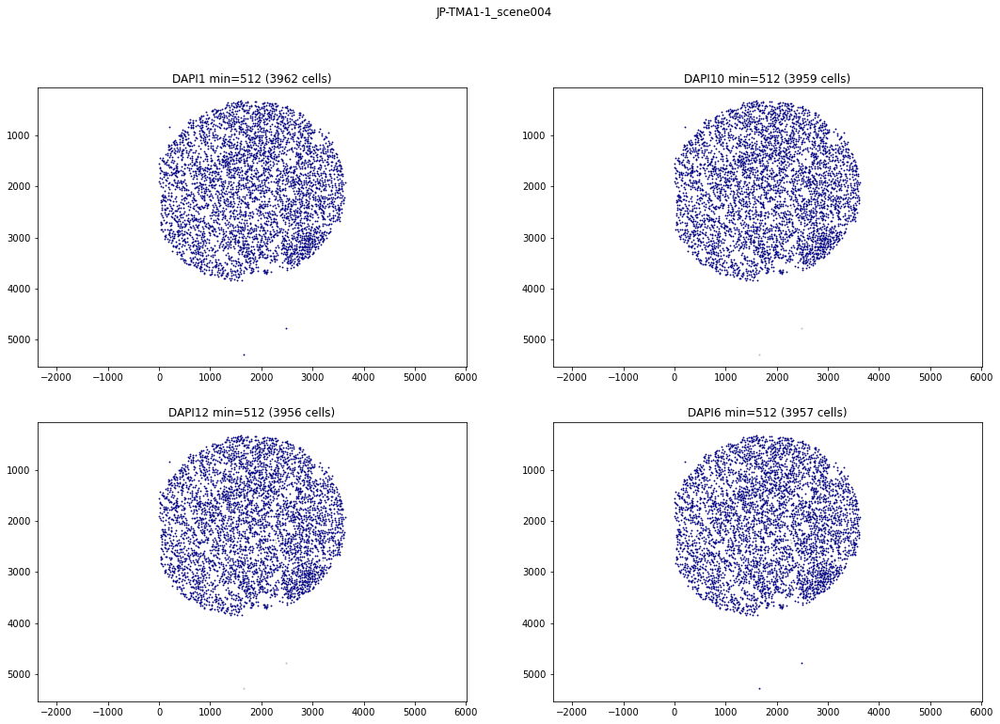

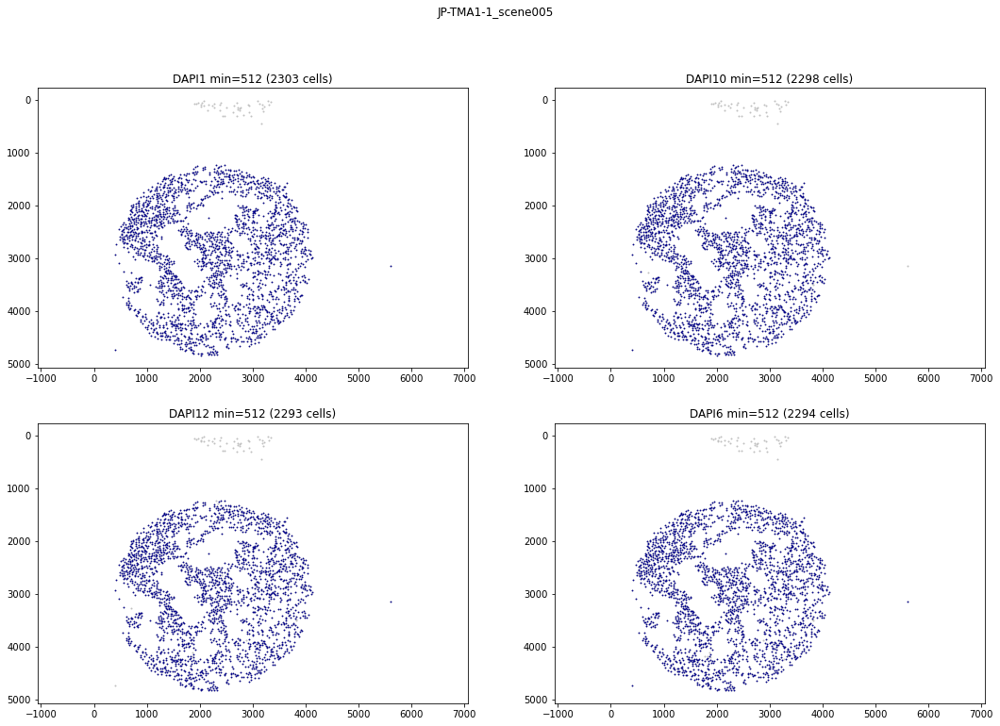

...

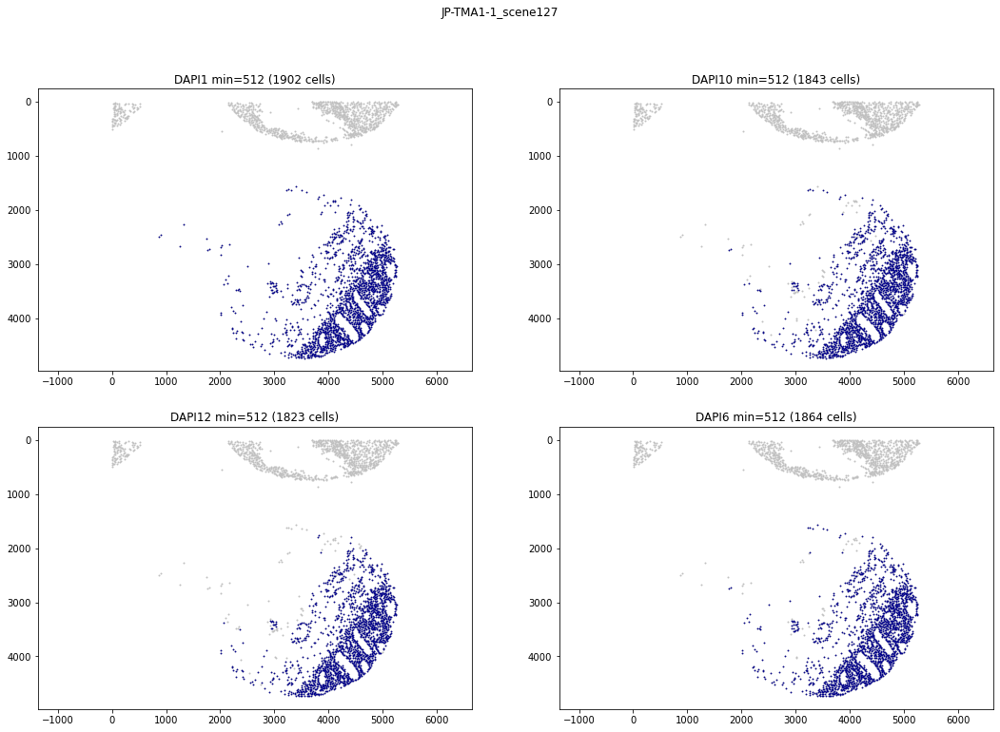

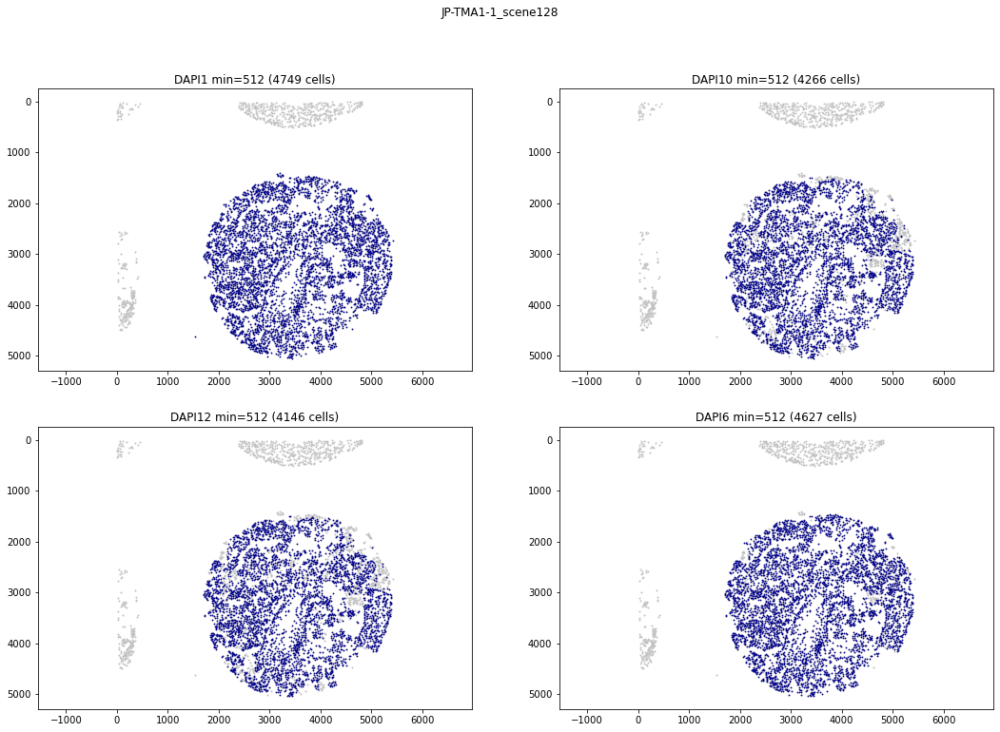

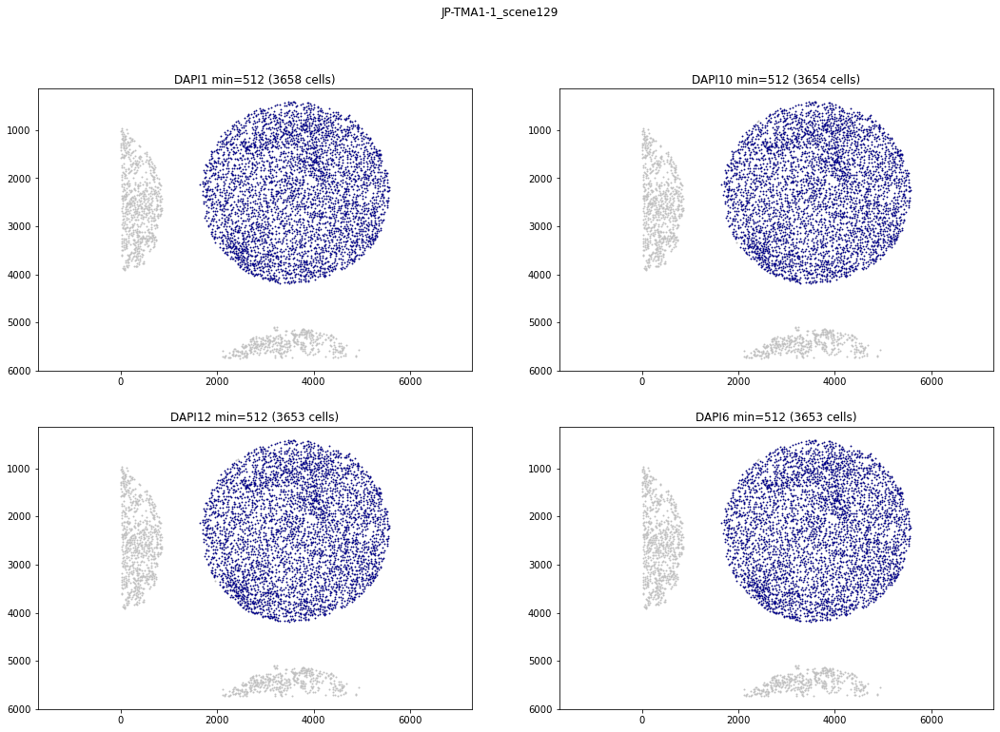

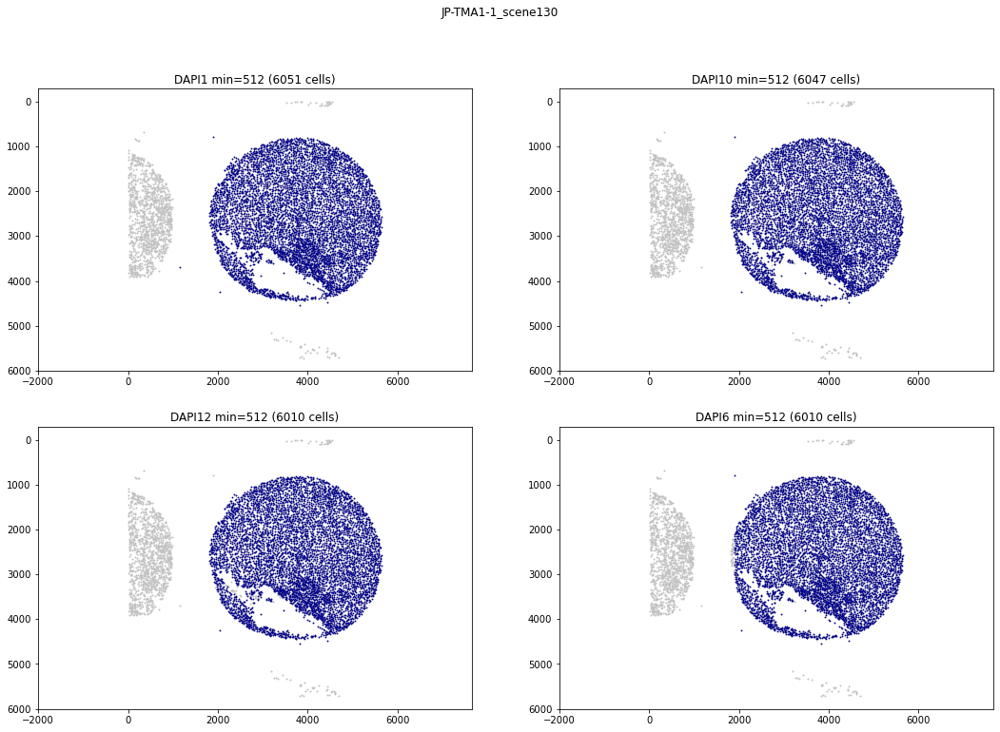

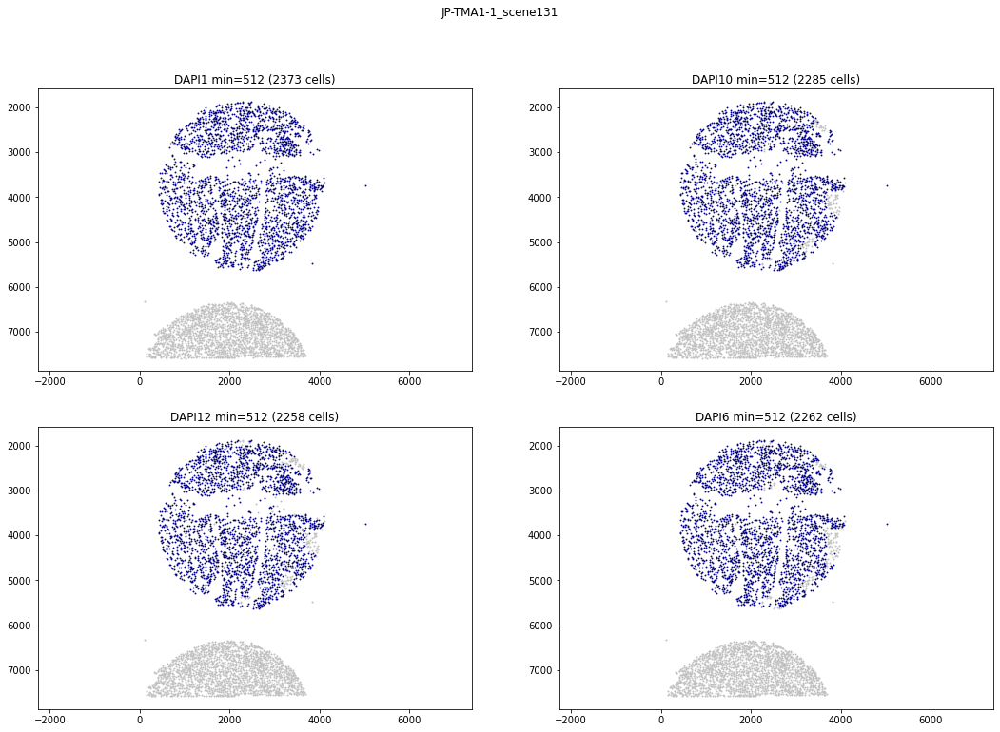

In [190]:
#markers by type
s_type = 'Tumor'
s_type = 'DAPI'
plt.ioff()

ls_fig = viz.plot_positive(s_type,d_combos,df_pos,d_thresh_record,df_xy)

#manual gating
#df_man = pd.read_csv(f'{codedir}/data/20211115_JP-TMAs_GatedPositiveCellNames.csv',index_col=0)
#df_man['celltype3'] = df_man.celltype.replace({'endothelial':'stromal','tumor':'epithelial'})

In [191]:
df_pos.loc[:,['DAPI1','DAPI6','DAPI10','DAPI12']].sum()/543535

DAPI1     1.000074
DAPI6     0.930946
DAPI10    0.885871
DAPI12    0.850462
dtype: float64

In [195]:
len(df_pos_manual)
s_date

'20211207'

In [192]:
df_pos_manual = pd.merge(df_pos,df_xy.loc[:,['DAPI_X','DAPI_Y']],left_index=True,right_index=True)

In [197]:
s_out = '20211207_JP-TMA1_ManualPositive.csv'
if not os.path.exists(s_out):
    print('saving csv')
    df_pos_manual.to_csv(s_out)

saving csv


### gating <a name="gating"></a>

specify combinations of manual postive/negative to get heiarchically gated call types

[contents](#contents)

In [23]:
#gating
# library
import os
import pandas as pd
import shutil
from mplex_image import analyze
import numpy as np

# const input output
s_path = "/home/groups/graylab_share/OMERO.rdsStore/engje/Data/20200000/20200406_JP-TMAs/data"

ls_file = ["20211207_JP-TMA1_ManualPositive"] 
s_out = '20211207_JP-TMA1'

df_data = pd.DataFrame()

for s_file in ls_file:
    print(f'Loading {s_file}')
    df_tt = pd.read_csv(f'{s_path}/{s_file}.csv', index_col=0)
    df_data=df_data.append(df_tt, sort=True)

# do we want slide or scene?
df_data['slide'] = [item.split('_')[0] for item in df_data.index]
df_data['scene'] = [item.split('_')[1] for item in df_data.index]
#call slide_scene "slide"
df_data['slide'] = df_data.slide + '_' + df_data.scene
df_data.drop('scene',axis=1,inplace=True)

Loading 20211207_JP-TMA1_ManualPositive


In [24]:
#parameters (as in 20210312_JP_TNP-TMAs_GateCellTypes.pynb)
from mplex_image import gating
# cell types
ls_endothelial = ['CD31']
ls_immune = ['CD45','CD3'] #no 'CD68 for JP-TMA AACR analysis
ls_tumor = ['CK7','CK19','CK5','CK14','Ecad'] 
ls_prolif = ['Ki67']

#tcell/myeloid
s_tcell = 'CD3' 
s_bcell = 'CD20'
s_myeloid = 'CD68'
ls_immune_functional = ['PD1','FoxP3','Ki67','GRNZB'] #

#luminal/basal/mesenchymal
ls_luminal = ['CK19','CK7','CK8'] #
ls_basal = ['CK5','CK14','CK17'] 
ls_mes = ['Vim'] 
ls_tumor_plus = ['EGFR', 'CD44', 'Ecad', 'Lum_all', 'Bas_all', 'Mes_all', 'ER', 'HER2_all']
ls_stromal_function =  ['Vim','aSMA','PDPN','ColI','CD68'] #'CAV1',
ls_tumor_prolif = ['PCNA','Ki67','pHH3']  
ls_tumor_signal = ['CoxIV','pS6RP','LamAC','pRB']#['BCL2','CoxIV','pS6RP']

#index of cell line samples (i.e. 100% tumor)
ls_cellline_index = ['TNP-TMA-7_scene11','TNP-TMA-7_scene13','TNP-TMA-7_scene19',
                    'TNP-TMA-7_scene22','TNP-TMA-7_scene33','TNP-TMA-7_scene38',
                    'TNP-TMA-7_scene42','TNP-TMA-7_scene44','TNP-TMA-7_scene55',
                    'TNP-TMA-7_scene66','TNP-TMA-7_scene77','TNP-TMA-7_scene78',
                    'TNP-TMA-7_scene82','TNP-TMA-7_scene88','JE-TMA-63_scene06',
                    'JE-TMA-63_scene02','JE-TMA-63_scene03','JE-TMA-63_scene05',
                    'JE-TMA-63_scene08','JE-TMA-63_scene09','JE-TMA-63_scene10',
                    'JE-TMA-63_scene11','JE-TMA-63_scene13','JE-TMA-63_scene14',
                    'JE-TMA-42_scene02','JE-TMA-42_scene03','JE-TMA-42_scene05','JE-TMA-42_scene06',
                    'JE-TMA-42_scene08','JE-TMA-42_scene09','JE-TMA-42_scene10',
                    'JE-TMA-42_scene11','JE-TMA-42_scene13','JE-TMA-42_scene14']
d_rename = {'CD4':'CD4_Ring','CD8':'CD8_Ring',
           'HER2':'HER2_Ring','ER':'ER_Nuclei','PgR':'PgR_Nuclei'}
df_data = df_data.rename(d_rename, axis=1)
if df_data.columns.str.contains('PgR_Nuclei').sum() > 0:
    df_data.drop('PgR_Nuclei',axis=1,inplace=True)
df_data.columns

Index(['AR', 'BMP2', 'CD20', 'CD3', 'CD31', 'CD4_Ring', 'CD44', 'CD45', 'CD68',
       'CD8_Ring', 'CK14', 'CK17', 'CK19', 'CK5', 'CK7', 'CK8', 'ColIV',
       'CoxIV', 'DAPI1', 'DAPI10', 'DAPI12', 'DAPI5', 'DAPI6', 'DAPI_X',
       'DAPI_Y', 'EGFR', 'ER_Nuclei', 'Ecad', 'FoxP3', 'GRNZB', 'Glut1',
       'H3K27', 'H3K4', 'HER2_Ring', 'Ki67', 'LamAC', 'LamB1', 'LamB2', 'PCNA',
       'PD1', 'PDPN', 'Vim', 'aSMA', 'pAKT', 'pERK', 'pHH3', 'pRB', 'pS6RP',
       'slide'],
      dtype='object')

In [206]:
%%capture
#custom gating
df_data = gating.main_celltypes(df_data,ls_endothelial,ls_immune,ls_tumor,ls_cellline_index)
df_data = gating.proliferation(df_data,ls_prolif)
df_data = gating.immune_types(df_data,s_myeloid,s_bcell,s_tcell)
df_data = gating.immune_functional(df_data,ls_immune_functional)
df_data = gating.cell_prolif(df_data)
df_data = gating.diff_hr_state(df_data,ls_luminal,ls_basal,ls_mes)

In [207]:
#have to use lum all Bas all 
(df_data.loc[((df_data.celltype=='tumor') & (~df_data.slide_scene.isin(ls_cellline_index))),['Lum_all','Bas_all','Ecad']].sum(axis=1)==0).sum()

0

In [208]:
%%capture
#even more tumor states
df_func = analyze.combinations(df_data,ls_tumor_plus)
s_celltype = 'tumor'
s_new_name='TumorDiffPlus'
df_data = df_data.merge(df_func,how='left', left_index=True, right_index=True, suffixes = ('_all',''))
ls_cell_names = df_func.columns.tolist()
analyze.add_celltype(df_data, ls_cell_names, s_new_name)
df_data.loc[df_data[df_data.celltype != s_celltype].index,s_new_name] = np.nan
d_replace = dict(zip(df_data.loc[:,'TumorDiffPlus'].dropna().unique(),[item.replace('_all','') for item in df_data.loc[:,'TumorDiffPlus'].dropna().unique()]))
df_data['TumorDiffPlus'] = df_data.TumorDiffPlus.replace(d_replace)

In [209]:
%%capture
#general gating
df_data = gating.celltype_gates(df_data,ls_tumor_prolif,s_new_name='TumorProlif',s_celltype='tumor')
#df_data = gating.celltype_gates(df_data,ls_tumor_plus,s_new_name='TumorDiffPlus',s_celltype='tumor')
df_data = gating.celltype_gates(df_data,ls_stromal_function,s_new_name='StromalType',s_celltype='stromal')
df_data = gating.celltype_gates(df_data,ls_tumor_signal,s_new_name='TumorSignal',s_celltype='tumor')
df_data = gating.non_tumor(df_data)

In [210]:
#check
#df_data.loc[:,df_data.dtypes=='object'].columns
#s_sample

Index(['slide', 'celltype', 'slide_scene', 'proliferation', 'ImmuneType',
       'FuncImmune', 'CellProlif', 'DiffState', 'HRStatus',
       'DiffStateHRStatus', 'TumorDiffPlus', 'TumorProlif', 'StromalType',
       'TumorSignal', 'NonTumor', 'NonTumorFunc'],
      dtype='object')

In [211]:
#drop extra colums
df_gate = df_data.loc[:,df_data.dtypes!='bool']#.drop(['BMP2', 'ColIV', 'Glut1', 'pAKT', 'H3K27', 'LamB1', 'LamB2', 'pERK',
       #'CSF1R', 'CAV1', 'BCL2', 'MUC1', 'CCND1', 'RAD51', 'gH2AX'],axis=1)

In [215]:
s_out = '20211207_JP-TMA1'
if not os.path.exists(f'{s_out}_GatedPositiveCellNames.csv'):
    print('saving new csv')
    df_gate.to_csv(f'{s_out}_GatedPositiveCellNames.csv')

saving new csv


### load gated 
and plot

In [25]:
s_gate = '20211207_JP-TMA1_GatedPositiveCellNames.csv'
df_data = pd.read_csv(s_gate,index_col=0)

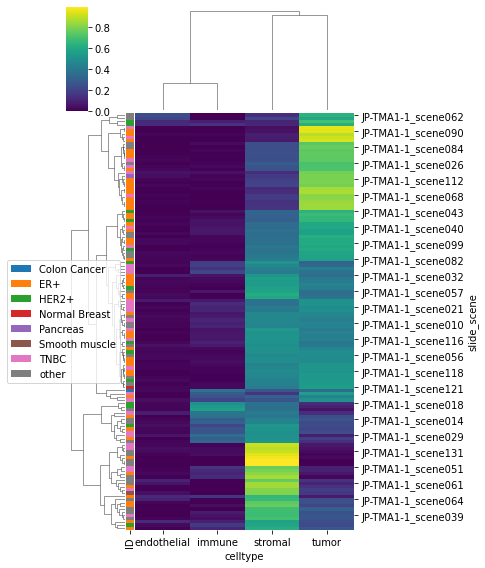

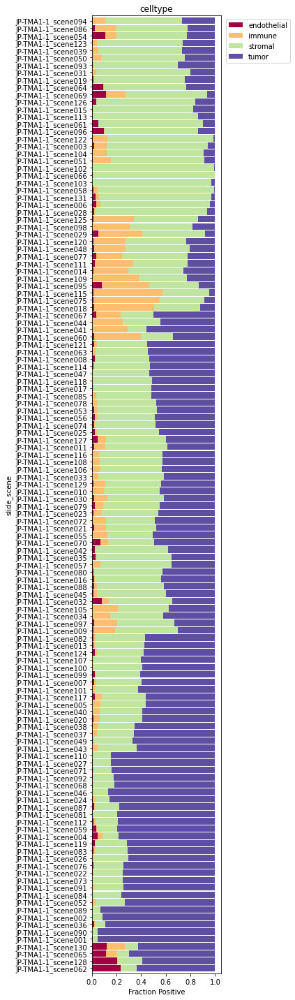

In [26]:
%matplotlib inline
s_grouper='slide_scene'
for s_scene in set(df_data.slide_scene.unique()).difference(df_cyc_a.index):
    df_cyc_a.loc[s_scene,'ID'] = 'other'
df_annot = df_cyc_a
df_data['countme'] = True

#calculate proportions
ls_cell = ['celltype',  'proliferation', 'ImmuneType','FuncImmune', 'CellProlif', 'DiffState', 'HRStatus',
       'DiffStateHRStatus', 'TumorDiffPlus', 'TumorProlif', 'StromalType','TumorSignal', 'NonTumor', 'NonTumorFunc']
for s_cell in ls_cell:
    df_prop = viz.prop_positive(df_data,s_cell=s_cell,s_grouper=s_grouper)
    # make annotations
    ls_samp_type = sorted(df_cyc_a.loc[df_data.slide_scene.unique()].ID.unique())
    lut = dict(zip(ls_samp_type,cm.tab10.colors))
    g, df_plot_less = viz.prop_clustermap(df_prop,df_annot,i_thresh =.005,lut=lut,figsize=(6,8))
    g.savefig(f'./GatingPlots/{s_cell}_clustermap.png',dpi=150)
    #plt.close()
    df_plot_less = df_plot_less.iloc[g.dendrogram_row.reordered_ind]
    df_plot_less.columns = [item.replace('___','') for item in df_plot_less.columns]
    fig = viz.prop_barplot(df_plot_less,s_cell,colormap="Spectral",figsize=(6,20),b_sort=False)
    fig.savefig(f'./GatingPlots/{s_cell}_bar.png',dpi=200)
    break

### colocalization <a name="coloc"></a>

load pixel coverage per single cell segmentation mask (calculated in 20201005_JP-TMA_Pipeline.py)

calculate manders coeffcients differentiate true double positive cells from false positive caused by lateral bleed through

[contents](#contents)

In [63]:
df_coloc = pd.DataFrame()
for s_slide in ['JP-TMA1-1','JP-TMA2-1','JE-TMA-42','TNP-TMA-7','JE-TMA-63',]:
    df_coloc = df_coloc.append(pd.read_csv(f'{codedir}/data/features_{s_slide}_Colocalization.csv',index_col=0))
    break

In [65]:
df_coloc.head()

,nuclei_area,DAPI_Y,DAPI_X,nuclei_eccentricity,slide_scene,Vim-CK19_pearsont,Vim-CK19_M1,Vim-CK19_M2,Vim-CK7_pearsont,Vim-CK7_M1,...,EGFR-CK7_M2,EGFR-CK8_pearsont,EGFR-CK8_M1,EGFR-CK8_M2,EGFR-CK5_pearsont,EGFR-CK5_M1,EGFR-CK5_M2,EGFR-Ecad_pearsont,EGFR-Ecad_M1,EGFR-Ecad_M2
JP-TMA1-1_scene083_cell1,161,2.863354,4231.621118,0.943816,JP-TMA1-1_scene083,0.0,0.0,0.0,0.0,0.0,...,1.0,0.840644,1.000000,1.0,0.996100,1.0,1.0,0.835896,1.000000,1.0
JP-TMA1-1_scene083_cell2,119,2.840336,4472.151261,0.906376,JP-TMA1-1_scene083,0.0,0.0,0.0,0.0,0.0,...,1.0,0.443484,0.113208,1.0,0.997942,1.0,1.0,0.000000,0.000000,0.0
JP-TMA1-1_scene083_cell3,63,2.492063,4549.142857,0.778117,JP-TMA1-1_scene083,0.0,0.0,0.0,0.0,0.0,...,1.0,0.000000,0.000000,0.0,0.996554,1.0,1.0,0.608322,0.908257,1.0
JP-TMA1-1_scene083_cell4,107,3.747664,4078.308411,0.751617,JP-TMA1-1_scene083,0.0,0.0,0.0,0.0,0.0,...,1.0,0.622935,0.725000,1.0,0.994389,1.0,1.0,0.000000,0.000000,0.0
JP-TMA1-1_scene083_cell5,100,3.370000,4569.380000,0.681606,JP-TMA1-1_scene083,0.0,0.0,0.0,0.0,0.0,...,1.0,0.000000,0.000000,0.0,0.996486,1.0,1.0,-0.060980,0.085791,1.0


In [66]:
# gate with M2 (not used)
d_coloc = {'CD44_Ecad':(['CD44-Ecad_M2'],'Ecad'),
           'CD44_Ecad_Lum':(['CD44-Ecad_M2','CD44-CK7_M2'],'Ecad_Lum'),
           'CD44_Lum':(['CD44-CK7_M2'],'Lum'),
           'EGFR_Ecad':(['EGFR-Ecad_M2'],'Ecad'),
           'EGFR_Ecad_Lum':(['EGFR-Ecad_M2','EGFR-CK7_M2'],'Ecad_Lum'),
           'Ecad_Lum_Mes':(['Vim-Ecad_M2','Vim-CK7_M2'],'Ecad_Lum'),
           'Ecad_Mes':(['Vim-Ecad_M2'],'Ecad'),
           'Ecad_Bas':(['CK14-Ecad_M2','CK5-Ecad_M2'],'Ecad'),
           'Ecad_Lum_Bas':(['CK14-Ecad_M2','CK5-Ecad_M2','CK5-CK7_M2','CK14-CK7_M2'],'Ecad_Lum'), 
           'Lum_Bas':(['CK5-CK7_M2','CK14-CK7_M2'],'Lum'), 
           'Lum_Mes':(['Vim-CK7_M2'],'Lum'),
          }
i_thresh = .8
s_celltype = 'TumorDiffPlus'
for s_cell, tu_coloc in d_coloc.items():
    se_coloc_bool = (df_coloc.loc[df_coloc.index.isin(df_data[df_data.loc[:,s_celltype]==s_cell].index),tu_coloc[0]] > i_thresh).any(axis=1)
    #M2 high: is double positive
    index_coloc = df_data.loc[se_coloc_bool.index].loc[se_coloc_bool].index
    df_data.loc[index_coloc,f'{s_celltype}_M2'] = s_cell
    # m2 low: not double positive
    index_not_coloc =df_data.loc[se_coloc_bool.index].loc[~se_coloc_bool].index
    df_data.loc[index_not_coloc,f'{s_celltype}_M2'] = tu_coloc[1]
    print(df_data.loc[se_coloc_bool.index].groupby(f'{s_celltype}_M2').countme.count())
df_data.loc[:,f'{s_celltype}_M2'] = df_data.loc[:,f'{s_celltype}_M2'].fillna(df_data.loc[:,f'{s_celltype}'])

TumorDiffPlus_M2
CD44_Ecad    4757
Ecad         2324
Name: countme, dtype: int64
TumorDiffPlus_M2
CD44_Ecad_Lum    2492
Ecad_Lum         3321
Name: countme, dtype: int64
TumorDiffPlus_M2
CD44_Lum    111
Lum         261
Name: countme, dtype: int64
TumorDiffPlus_M2
EGFR_Ecad     62
Ecad         404
Name: countme, dtype: int64
TumorDiffPlus_M2
EGFR_Ecad_Lum    3821
Ecad_Lum         1804
Name: countme, dtype: int64
TumorDiffPlus_M2
Ecad_Lum        6569
Ecad_Lum_Mes    2641
Name: countme, dtype: int64
TumorDiffPlus_M2
Ecad        3749
Ecad_Mes    1636
Name: countme, dtype: int64
TumorDiffPlus_M2
Ecad        2070
Ecad_Bas    1121
Name: countme, dtype: int64
TumorDiffPlus_M2
Ecad_Lum        2757
Ecad_Lum_Bas    3790
Name: countme, dtype: int64
TumorDiffPlus_M2
Lum        643
Lum_Bas    761
Name: countme, dtype: int64
TumorDiffPlus_M2
Lum        2171
Lum_Mes     751
Name: countme, dtype: int64


In [67]:
# gate with M1 and M2
d_coloc = {'CD44_Ecad':(['CD44-Ecad_M2'],['Ecad','stromal']),
           'CD44_Ecad_Lum':(['CD44-Ecad_M2','CD44-CK7_M2'],['Ecad_Lum','stromal']),
           'CD44_Lum':(['CD44-CK7_M2'],['Lum','stromal']),
           'EGFR_Ecad':(['EGFR-Ecad_M2'],['Ecad','Bas']), #keep EGFR alone as basal? could be artifact
           'EGFR_Ecad_Lum':(['EGFR-Ecad_M2','EGFR-CK7_M2'],['Ecad_Lum','Bas']),
           'Ecad_Lum_Mes':(['Vim-Ecad_M2','Vim-CK7_M2'],['Ecad_Lum','stromal_Vim']),
           'Ecad_Mes':(['Vim-Ecad_M2'],['Ecad','stromal_Vim']),
           'Ecad_Bas':(['CK14-Ecad_M2','CK5-Ecad_M2'],['Ecad','Bas']),
           'Ecad_Lum_Bas':(['CK14-Ecad_M2','CK5-Ecad_M2','CK5-CK7_M2','CK14-CK7_M2'],['Ecad_Lum','Bas']), 
           'Lum_Bas':(['CK5-CK7_M2','CK14-CK7_M2'],['Lum','Bas']), 
           'Lum_Mes':(['Vim-CK7_M2'],['Lum','stromal_Vim']),
          }
i_thresh = .8
s_celltype = 'TumorDiffPlus'
for s_cell, tu_coloc in d_coloc.items():
    ls_m1 = [item.replace('M2','M1') for item in tu_coloc[0]]
    se_coloc_bool_m2 = (df_coloc.loc[df_coloc.index.isin(df_data[df_data.loc[:,s_celltype]==s_cell].index),tu_coloc[0]] > i_thresh).any(axis=1)    
    se_coloc_bool_m1 = (df_coloc.loc[df_coloc.index.isin(df_data[df_data.loc[:,s_celltype]==s_cell].index),ls_m1] > i_thresh).any(axis=1)
    se_hihi = ((se_coloc_bool_m1) & (se_coloc_bool_m2))
    index_hihi = df_data.loc[se_coloc_bool_m1.index].loc[se_hihi].index
    se_lolo = ((se_coloc_bool_m1==False) & (se_coloc_bool_m2==False))
    index_lolo = df_data.loc[se_coloc_bool_m1.index].loc[se_lolo].index
    se_lohi = ((se_coloc_bool_m1==False) & (se_coloc_bool_m2))
    index_lohi = df_data.loc[se_coloc_bool_m1.index].loc[se_lohi].index
    se_hilo = ((se_coloc_bool_m1) & (se_coloc_bool_m2==False))
    index_hilo = df_data.loc[se_coloc_bool_m1.index].loc[se_hilo].index
    # M1 low and M2 low: go to M2 (tumor) (could go to M1; toss up) 
    df_data.loc[index_lolo,f'{s_celltype}_M1'] = tu_coloc[1][0]
    # M1 hi and M2 hi: stay as s_cell
    df_data.loc[index_hihi,f'{s_celltype}_M1'] = s_cell
    # M1 hi and M2 low: got to M2 (tumor)
    df_data.loc[index_hilo,f'{s_celltype}_M1'] = tu_coloc[1][0]
    # M1 low and M2 hi: go to M1 (basal or stromal)
    df_data.loc[index_lohi,f'{s_celltype}_M1'] = tu_coloc[1][1]
    print(df_data.loc[se_coloc_bool_m1.index].groupby(f'{s_celltype}_M1').countme.count())
    #break
df_data.loc[:,f'{s_celltype}_M1'] = df_data.loc[:,f'{s_celltype}_M1'].fillna(df_data.loc[:,f'{s_celltype}'])
#stromal is not tumor
d_replace = {'stromal':np.NaN, 'stromal_Vim':np.NaN}
df_data.loc[:,f'{s_celltype}_M1M2'] = df_data.loc[:,f'{s_celltype}_M1'].replace(d_replace)

TumorDiffPlus_M1
CD44_Ecad    3606
Ecad         2324
stromal      1151
Name: countme, dtype: int64
TumorDiffPlus_M1
CD44_Ecad_Lum    2142
Ecad_Lum         3321
stromal           350
Name: countme, dtype: int64
TumorDiffPlus_M1
CD44_Lum      6
Lum         261
stromal     105
Name: countme, dtype: int64
TumorDiffPlus_M1
Bas           15
EGFR_Ecad     47
Ecad         404
Name: countme, dtype: int64
TumorDiffPlus_M1
Bas               252
EGFR_Ecad_Lum    3569
Ecad_Lum         1804
Name: countme, dtype: int64
TumorDiffPlus_M1
Ecad_Lum        6569
Ecad_Lum_Mes    1375
stromal_Vim     1266
Name: countme, dtype: int64
TumorDiffPlus_M1
Ecad           3749
Ecad_Mes        628
stromal_Vim    1008
Name: countme, dtype: int64
TumorDiffPlus_M1
Bas          269
Ecad        2070
Ecad_Bas     852
Name: countme, dtype: int64
TumorDiffPlus_M1
Bas              385
Ecad_Lum        2757
Ecad_Lum_Bas    3405
Name: countme, dtype: int64
TumorDiffPlus_M1
Bas        337
Lum        643
Lum_Bas    424
Name: count

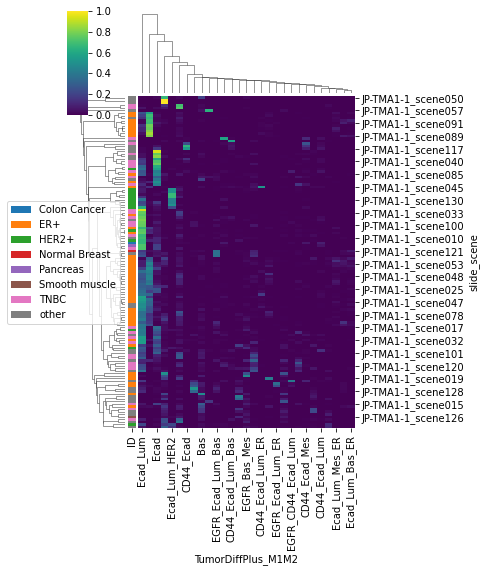

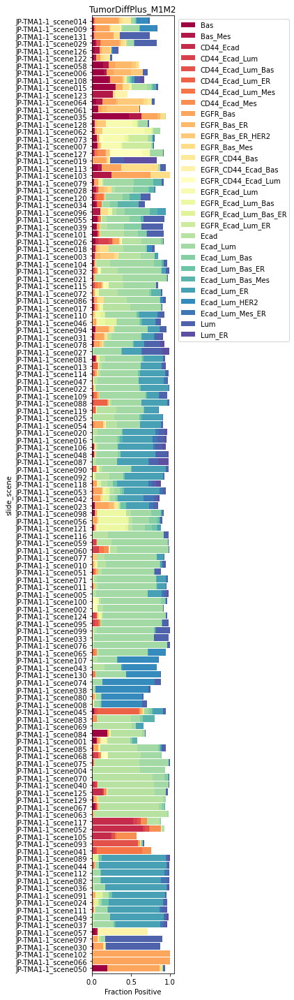

In [68]:
%matplotlib inline
s_grouper='slide_scene'
for s_scene in set(df_data.slide_scene.unique()).difference(df_cyc_a.index):
    df_cyc_a.loc[s_scene,'ID'] = 'other'
df_annot = df_cyc_a
df_data['countme'] = True

#calculate proportions
ls_cell = [ 'TumorDiffPlus_M1M2', ]
for s_cell in ls_cell:
    df_prop = viz.prop_positive(df_data,s_cell=s_cell,s_grouper=s_grouper)
    # make annotations
    ls_samp_type = sorted(df_cyc_a.loc[df_data.slide_scene.unique()].ID.unique())
    lut = dict(zip(ls_samp_type,cm.tab10.colors))
    g, df_plot_less = viz.prop_clustermap(df_prop,df_annot,i_thresh =.005,lut=lut,figsize=(6,8))
    g.savefig(f'./GatingPlots/{s_cell}_clustermap.png',dpi=150)
    #plt.close()
    df_plot_less = df_plot_less.iloc[g.dendrogram_row.reordered_ind]
    df_plot_less.columns = [item.replace('___','') for item in df_plot_less.columns]
    fig = viz.prop_barplot(df_plot_less,s_cell,colormap="Spectral",figsize=(6,20),b_sort=False)
    fig.savefig(f'./GatingPlots/{s_cell}_bar.png',dpi=200)
    break

In [73]:
#correct cell types
print(len(df_data.loc[(df_data.celltype=='tumor') & (df_data.TumorDiffPlus_M1M2.isna())]))
ls_index  =df_data.loc[(df_data.celltype=='tumor') & (df_data.TumorDiffPlus_M1M2.isna())].index
#update gates
#cell type
df_data.loc[ls_index,'celltype'] = 'stromal'
df_data.loc[ls_index,'CellProlif'] = 'stromal'
df_data.loc[((df_data.celltype=='stromal') & (df_data.proliferation=='prolif')),'CellProlif'] = 'stromal_prolif'
df_data.loc[((df_data.celltype=='stromal') & (df_data.proliferation=='nonprolif')),'CellProlif'] = 'stromal_nonprolif' #added 7/13
#tumor
df_data.loc[ls_index,'DiffState'] = np.NaN
df_data.loc[ls_index,'HRStatus'] = np.NaN
df_data.loc[ls_index,'DiffStateHRStatus'] = np.NaN
df_data.loc[ls_index,'TumorDiffPlus'] = np.NaN
df_data.loc[ls_index,'TumorProlif'] = np.NaN
df_data.loc[ls_index,'TumorSignal'] = np.NaN


4475


In [76]:
#check 
s_pos = '20211207_JP-TMA1_ManualPositive.csv'
df_pos = pd.read_csv(s_pos,index_col=0)

In [80]:
#immune do not need fixing (no CD3 or CD45 pos)
for s_marker in ['CD45','CD3','CD68','Vim','aSMA','Ki67','ColIV','PDPN']:
    print(s_marker)
    print(df_pos.loc[df_pos.index.isin(ls_index),s_marker].sum())

CD45
0
CD3
0
CD68
636
Vim
2869
aSMA
276
Ki67
167
ColIV
96
PDPN
93


In [81]:
df_pos.loc[df_data.index,'celltype'] = df_data.celltype
# re-gate stromal
ls_stromal_function =  ['Vim','aSMA','PDPN','ColIV','CD68']
df_pos = gating.celltype_gates(df_pos,ls_stromal_function,s_new_name='StromalType',s_celltype='stromal')

('CD68',)
('ColIV',)
('PDPN',)
('Vim',)
('aSMA',)
('CD68', 'ColIV')
('CD68', 'PDPN')
('CD68', 'Vim')
('CD68', 'aSMA')
('ColIV', 'PDPN')
('ColIV', 'Vim')
('ColIV', 'aSMA')
('PDPN', 'Vim')
('PDPN', 'aSMA')
('Vim', 'aSMA')
('CD68', 'ColIV', 'PDPN')
('CD68', 'ColIV', 'Vim')
('CD68', 'ColIV', 'aSMA')
('CD68', 'PDPN', 'Vim')
('CD68', 'PDPN', 'aSMA')
('CD68', 'Vim', 'aSMA')
('ColIV', 'PDPN', 'Vim')
('ColIV', 'PDPN', 'aSMA')
('ColIV', 'Vim', 'aSMA')
('PDPN', 'Vim', 'aSMA')
('CD68', 'ColIV', 'PDPN', 'Vim')
('CD68', 'ColIV', 'PDPN', 'aSMA')
('CD68', 'ColIV', 'Vim', 'aSMA')
('CD68', 'PDPN', 'Vim', 'aSMA')
('ColIV', 'PDPN', 'Vim', 'aSMA')
('CD68', 'ColIV', 'PDPN', 'Vim', 'aSMA')


In [82]:
#double check same len
print(len(df_pos))
print(len(df_data))
df_data['StromalType'] = df_pos.loc[df_data.index,'StromalType']

543692
543692


In [83]:
#NonTumor and NonTumorFunc
df_data.loc[df_data.celltype=='stromal','NonTumor']  = df_data.loc[df_data.celltype=='stromal','StromalType']
df_data.loc[df_data.celltype=='stromal','NonTumorFunc']  = df_data.loc[df_data.celltype=='stromal','StromalType']

In [86]:
s_coloc = '20211207_JP-TMA1_GatedCellTypes_M1M2.csv'
if not os.path.exists(s_coloc):
    print('saving csv')
    df_data.to_csv(s_coloc)

#df = pd.read_csv(f'{s_out}_GatedCellTypes_M1M2.csv',index_col=0)

saving csv


# Background subtract <a name="leiden"></a>

subtract background intensity defined by manual thresholds


[contents](#contents)

In [27]:
s_mi =  f'{codedir}/data/20211207_JP-TMA1_FilteredMeanIntensity.csv'
df_mi2 = pd.read_csv(s_mi,index_col=0)

In [28]:
len(df_mi2)

543692

In [29]:
ls_sample = ['JP-TMA1-1']
df_mi2['slide'] = [item.split('_')[0] for item in df_mi2.slide_scene]

In [30]:
#subtract background
df_bg_all = pd.DataFrame()
for s_sample in ls_sample:
    print(s_sample)
    d_bg = df_thresh[df_thresh.slide==s_sample].loc['global'].dropna().drop('slide').to_dict()
    df_bg = df_mi2[df_mi2.slide==s_sample].copy()
    print(len(df_bg))
    for s_marker, i_thresh in d_bg.items():
        df_bg[s_marker] = np.clip(df_mi2.loc[df_mi2.slide==s_sample,s_marker] - i_thresh*256, a_min=0, a_max=None)
    df_bg_all = df_bg_all.append(df_bg)
    #break

JP-TMA1-1
543692


In [32]:
#s_out = f'{codedir}/data/20211115_JP-TMAs_BGSubtractedMeanIntensity.csv'
s_out = f'{codedir}/data/20211207_JP-TMA1_BGSubtractedMeanIntensity.csv'
if not os.path.exists(s_out):
    print('saving csv')
    df_bg_all.to_csv(s_out)

saving csv


## Umap <a name="l7"></a>

umap projection of single cells

[contents](#contents)

In [33]:
import scanpy as sc
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [38]:
os.chdir(datadir)
s_gate = '20211207_JP-TMA1_GatedPositiveCellNames.csv'
df_man = pd.read_csv(s_gate,index_col=0)
df_norm = pd.read_csv('20211207_JP-TMA1_BGSubtractedMeanIntensity.csv',index_col=0)
df_man['celltype3'] = df_man.celltype.replace({'tumor':'epithelial','endothelial':'stromal'})

In [44]:
d_replace = {'Basal like Cells':'TNBC', 'Claudin-Low Cells':'TNBC', 'Colon Cancer':'other', #'ER+',
 'HER2 Cells':'HER2+', #'HER2+',
 'Luminal A Cells':'ER+', 'Luminal B Cells':'ER+',
 #'Normal Breast', #'Normal Tonsil',
 'Pancreas':'other', 'Smooth muscle':'other',
 #'TNBC','other'
            }

In [45]:
#32 features

ls_col = ['EGFR', 'HER2', 'BMP2', 'CD20', 'CD3', 'CD31', 'CD4', 'CD44', 'CD45',
       'CD68', 'CD8',  'ColIV', 'CoxIV', 'Glut1', 'PD1', #'PDGFRa','ColI',
       'PDPN',  'R1c2', 'Vim', 'aSMA',
        'pS6RP', 'CK14', 'CK17',  'CK5', 'CK7', 'CK8',# 'Ecad','CK19',
       'AR', 'DAPI11', 'ER', 'FoxP3', 'GRNZB', 'H3K27', 'H3K4',  'Ki67', 'LamAC',
       'LamB1', 'LamB2', 'PCNA', 'PgR', 'area', #'cPARP', 'gH2AX', 'pERK', 'pHH3', 'pRB','HIF1a','pAKT','DAPI_Y', 'DAPI_X',
        'eccentricity']
print(len(ls_col))
#adata = sc.AnnData(df_norm.merge(df_both.loc[:,['area','eccentricity']],left_index=True,right_index=True).loc[:,ls_col])
adata = sc.AnnData(df_norm.loc[df_norm.DAPI12pos,ls_col]) #487449 cells versus 602881

40


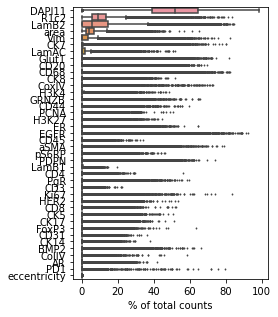

<Figure size 432x288 with 0 Axes>

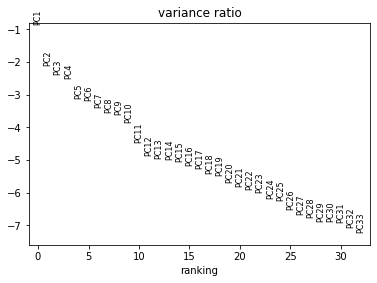

In [46]:
#raw
adata.raw = adata
#reduce dimensionality
sc.tl.pca(adata, svd_solver='auto')
fig,ax=plt.subplots(figsize=(3.5,5))
sc.pl.highest_expr_genes(adata, n_top=48,ax=ax,save=f'Expression_{len(ls_col)}.png')
plt.tight_layout()
sc.pl.pca_variance_ratio(adata,n_pcs=32, log=True)
adata.obs['TMA'] = [item.split('_')[0] for item in adata.obs.index]
adata.obs['slide_scene'] = [item.split('_cell')[0] for item in adata.obs.index]
adata.obs['subtype'] = adata.obs.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)
adata.obs['celltype3'] = df_man.loc[adata.obs.index,'celltype3']

In [ ]:
for n_neighbors in [15,30]:
    results_file = f'20211207_JP-TMA1_{n_neighbors}neighbors_{len(ls_col)}markers.h5ad'
    if not os.path.exists(results_file):
        print('calc umap')
        # calculate neighbors 
        sc.pp.neighbors(adata, n_neighbors=n_neighbors) #, method='rapids'
        sc.tl.umap(adata)
    else:
        print('loading umap')
        adata = sc.read_h5ad(results_file)
        adata.obs['slide_scene'] = [item.split('_cell')[0] for item in adata.obs.index]
        adata.obs['subtype'] = adata.obs.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)
        adata.obs['celltype3'] = df_man.loc[adata.obs.index,'celltype3']
    #save results

    #color by markers
    figname = f"Umap_markers_{n_neighbors}neighbors_{len(ls_col)}markers.png"
    sc.pl.umap(adata, color=ls_col,vmin='p1.5',vmax='p98.5',save=figname,ncols=8)
    #color by TMA
    figname = f"Umap_TMA_{n_neighbors}neighbors_{len(ls_col)}markers.png"
    fig,ax = plt.subplots(figsize=(3,3), dpi=200)
    sc.pl.umap(adata, color='TMA',wspace=.25,save=figname,ax=ax)
    
    figname = f"Umap_subtype_{n_neighbors}neighbors_{len(ls_col)}markers.png"
    fig,ax = plt.subplots(figsize=(3,3), dpi=200)
    sc.pl.umap(adata, color='subtype',wspace=.25,save=figname,ax=ax)
    
    figname = f"Umap_celltype3_{n_neighbors}neighbors_{len(ls_col)}markers.png"
    fig,ax = plt.subplots(figsize=(3,3), dpi=200)
    sc.pl.umap(adata, color='celltype3',wspace=.25,save=figname,ax=ax)
    
    if not os.path.exists(results_file):
        adata.write(results_file)
    break


In [529]:
#just TNBC - good tnbc markers
ls_col = ['EGFR', 'BMP2', # 'HER2',
 'CD3', 'CD31', 'CD4', 'CD44', 'CD45', 'CD68', 'CD8',
 'ColIV', 'CoxIV', 'Glut1', 'PD1', 'PDPN', 'R1c2',
 'Vim', 'aSMA', 'pS6RP', 'CK14', 'CK17', 'CK5', 'CK7', 'CK8', 'AR',
 'DAPI11','Ecad','CK19','FoxP3',# 'ER',  'FoxP3','GRNZB',: background
 'H3K27', 'H3K4', 'Ki67', 'LamAC', 'LamB1', 'LamB2', 'PCNA',# 'PgR',
 'area', 'eccentricity']

# just ER+, good ER+ makers #we don't want to use PD1 - bright spot show up in tumor
ls_col = ['EGFR', 'HER2', 'BMP2', 'CD20', 'CD3', 'CD31', 'CD4', 'CD44', 'CD45',
       'CD68', 'CD8',  'ColIV', 'CoxIV', 'Glut1', 'PD1', #'PDGFRa','ColI',
       'PDPN',  'R1c2', 'Vim', 'aSMA',
        'pS6RP', 'CK14', 'CK17',  'CK5', 'CK7', 'CK8',# 'Ecad','CK19',
       'AR', 'DAPI11', 'ER', 'FoxP3', 'GRNZB',   #'Ki67', 'LamAC','H3K27', 'H3K4','LamB1', 'LamB2',
        'PCNA', 'PgR', 'area', #'cPARP', 'gH2AX', 'pERK', 'pHH3', 'pRB','HIF1a','pAKT','DAPI_Y', 'DAPI_X',
        'eccentricity']

#plan for ER +: recluster: take out PD1, GRNZ, area, eccentricity, DAPI11 cluster 20 
# add ecad, CK19, Ki67
ls_col = ['EGFR', 'HER2', 'BMP2', 'CD20', 'CD3', 'CD31', 'CD4', 'CD44', 'CD45',
       'CD68', 'CD8',  'ColIV', 'CoxIV', 'Glut1', #'PD1', #'PDGFRa','ColI',
       'PDPN',  'R1c2', 'Vim', 'aSMA','Ecad','CK19','Ki67',
        'pS6RP', 'CK14', 'CK17',  'CK5', 'CK7', 'CK8',# 'Ecad','CK19',
       'AR',  'ER', 'FoxP3', #'GRNZB', 'DAPI11',  # 'LamAC','H3K27', 'H3K4','LamB1', 'LamB2',
        'PCNA', 'PgR',# 'eccentricity' 'area', #'cPARP', 'gH2AX', 'pERK', 'pHH3', 'pRB','HIF1a','pAKT','DAPI_Y', 'DAPI_X',
        ]

#ER+ 32 markers leiden 0.6 notes
# 17 is real, take out R1 c2
#don't understand 12. HER2 driven?? filter outliers HER2 q=.99999
#filter ouliters PD1: real PD1 is maximum 800-maybe 1300,use q=.9993.  artifact is 1600+
ls_col = ['EGFR', 'HER2', 'BMP2', 'CD20', 'CD3', 'CD31', 'CD4', 'CD44', 'CD45',
       'CD68', 'CD8',  'ColIV', 'CoxIV', 'Glut1', #'PD1', #'PDGFRa','ColI',
       'PDPN',  'Vim', 'aSMA','Ecad','CK19','Ki67', # 'R1c2',
        'pS6RP', 'CK14', 'CK17',  'CK5', 'CK7', 'CK8',# 'Ecad','CK19',
       'AR',  'ER', 'FoxP3', #'GRNZB', 'DAPI11',  # 'LamAC','H3K27', 'H3K4','LamB1', 'LamB2',
        'PCNA', 'PgR',# 'eccentricity' 'area', #'cPARP', 'gH2AX', 'pERK', 'pHH3', 'pRB','HIF1a','pAKT','DAPI_Y', 'DAPI_X',
        ]

ls_col = ['EGFR', 'HER2',  'CD20', 'CD3', 'CD31', 'CD4', 'CD44', 'CD45',#'BMP2',
       'CD68', 'CD8',  'ColIV', 'CoxIV', 'Glut1', 'PD1',# #'PDGFRa','ColI',
       'PDPN',  'Vim', 'aSMA','Ecad','CK19','Ki67',  'R1c2',
        'pS6RP', 'CK14', 'CK17',  'CK5', 'CK7', 'CK8','DAPI11',# 
       'AR',  'ER', 'FoxP3', #'GRNZB', 'DAPI11',  # 'LamAC','H3K27', 'H3K4','LamB1', 'LamB2',
        'PCNA', 'PgR',# 'eccentricity' 'area', #'cPARP', 'gH2AX', 'pERK', 'pHH3', 'pRB','HIF1a','pAKT','DAPI_Y', 'DAPI_X',
        ]
df_exclude = pd.read_csv('exclude_JP-TMA-1_ER+_34markers_leiden0.6_20.csv',index_col=0)

ls_exclude = ['JP-TMA1-1_scene038_cell6690', 'JP-TMA1-1_scene038_cell6694','JP-TMA1-1_scene038_cell6697', 'JP-TMA1-1_scene038_cell6698',  'JP-TMA1-1_scene038_cell6700', 'JP-TMA1-1_scene038_cell6701',
       'JP-TMA1-1_scene038_cell6702', 'JP-TMA1-1_scene038_cell6703', 'JP-TMA1-1_scene038_cell6704', 'JP-TMA1-1_scene038_cell6705',    'JP-TMA1-1_scene038_cell6706', 'JP-TMA1-1_scene038_cell6707',
       'JP-TMA1-1_scene038_cell6708', 'JP-TMA1-1_scene038_cell6709',       'JP-TMA1-1_scene038_cell6710', 'JP-TMA1-1_scene038_cell6711',       'JP-TMA1-1_scene038_cell6712', 'JP-TMA1-1_scene038_cell6713',       'JP-TMA1-1_scene038_cell6714', 'JP-TMA1-1_scene038_cell6715',
       'JP-TMA1-1_scene038_cell6716', 'JP-TMA1-1_scene038_cell6717',       'JP-TMA1-1_scene038_cell6718', 'JP-TMA1-1_scene038_cell6719',       'JP-TMA1-1_scene038_cell6720', 'JP-TMA1-1_scene038_cell6721',       'JP-TMA1-1_scene038_cell6722', 'JP-TMA1-1_scene038_cell6723',
       'JP-TMA1-1_scene038_cell6724', 'JP-TMA1-1_scene038_cell6725',       'JP-TMA1-1_scene038_cell6726', 'JP-TMA1-1_scene038_cell6727',       'JP-TMA1-1_scene038_cell6728', 'JP-TMA1-1_scene038_cell6729',       'JP-TMA1-1_scene038_cell6730', 'JP-TMA1-1_scene038_cell6731',
       'JP-TMA1-1_scene038_cell6732', 'JP-TMA1-1_scene038_cell6733',       'JP-TMA1-1_scene038_cell6734', 'JP-TMA1-1_scene038_cell6735',       'JP-TMA1-1_scene038_cell6736', 'JP-TMA1-1_scene038_cell6737',       'JP-TMA1-1_scene038_cell6738', 'JP-TMA1-1_scene038_cell6739',
       'JP-TMA1-1_scene038_cell6740', 'JP-TMA1-1_scene038_cell6741',       'JP-TMA1-1_scene038_cell6742', 'JP-TMA1-1_scene038_cell6743',       'JP-TMA1-1_scene038_cell6744', 'JP-TMA1-1_scene038_cell6745',       'JP-TMA1-1_scene038_cell6746', 'JP-TMA1-1_scene038_cell6747',
       'JP-TMA1-1_scene038_cell6748', 'JP-TMA1-1_scene038_cell6749',       'JP-TMA1-1_scene038_cell6750', 'JP-TMA1-1_scene038_cell6751',       'JP-TMA1-1_scene038_cell6752', 'JP-TMA1-1_scene038_cell6753',       'JP-TMA1-1_scene038_cell6754', 'JP-TMA1-1_scene038_cell6755',
       'JP-TMA1-1_scene038_cell6756', 'JP-TMA1-1_scene038_cell6757',       'JP-TMA1-1_scene038_cell6758', 'JP-TMA1-1_scene038_cell6759',       'JP-TMA1-1_scene038_cell6760', 'JP-TMA1-1_scene038_cell6761',       'JP-TMA1-1_scene038_cell6762', 'JP-TMA1-1_scene038_cell6763',
       'JP-TMA1-1_scene038_cell6764', 'JP-TMA1-1_scene038_cell6765',       'JP-TMA1-1_scene038_cell6766', 'JP-TMA1-1_scene038_cell6767',       'JP-TMA1-1_scene038_cell6768', 'JP-TMA1-1_scene038_cell6769',       'JP-TMA1-1_scene038_cell6770', 'JP-TMA1-1_scene038_cell6771',
       'JP-TMA1-1_scene038_cell6772', 'JP-TMA1-1_scene038_cell6773',       'JP-TMA1-1_scene038_cell6774', 'JP-TMA1-1_scene038_cell6775',       'JP-TMA1-1_scene038_cell6776', 'JP-TMA1-1_scene038_cell6777',       'JP-TMA1-1_scene038_cell6778', 'JP-TMA1-1_scene038_cell6779',
       'JP-TMA1-1_scene038_cell6780', 'JP-TMA1-1_scene038_cell6781',       'JP-TMA1-1_scene038_cell6782', 'JP-TMA1-1_scene038_cell6783',       'JP-TMA1-1_scene038_cell6784', 'JP-TMA1-1_scene038_cell6785',       'JP-TMA1-1_scene038_cell6786', 'JP-TMA1-1_scene038_cell6787',
       'JP-TMA1-1_scene038_cell6788', 'JP-TMA1-1_scene038_cell6789',       'JP-TMA1-1_scene038_cell6790', 'JP-TMA1-1_scene038_cell6791',       'JP-TMA1-1_scene038_cell6792',
        'JP-TMA1-1_scene038_cell3327', 'JP-TMA1-1_scene080_cell1795',       'JP-TMA1-1_scene038_cell574', 'JP-TMA1-1_scene009_cell5642',
       'JP-TMA1-1_scene038_cell3278', 'JP-TMA1-1_scene092_cell4080'  #HER2
             ]
ls_exclude_all = sorted(set(df_norm[df_norm.loc[:,'PD1'] > 1365].loc[:,'PD1'].index.tolist()).union(set(ls_exclude))) #PD1
df_exclude = df_exclude.append(pd.DataFrame(index=ls_exclude_all,columns=df_exclude.columns))
#df_exclude.to_csv('exclude_JP-TMA-1_ER+_34markers_leiden0.6_20_HER2_PD1_AF.csv')
df_norm['subtype'] = df_norm.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)

In [530]:
print(len(ls_col))
(df_norm.index.isin(df_exclude.index)).sum()

33


2195

loading umap


/home/exacloud/gscratch/Chin_Lab/engje/bin/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'TMA' as categorical
/home/exacloud/gscratch/Chin_Lab/engje/bin/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'slide_scene' as categorical
/home/exacloud/gscratch/Chin_Lab/engje/bin/miniconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.

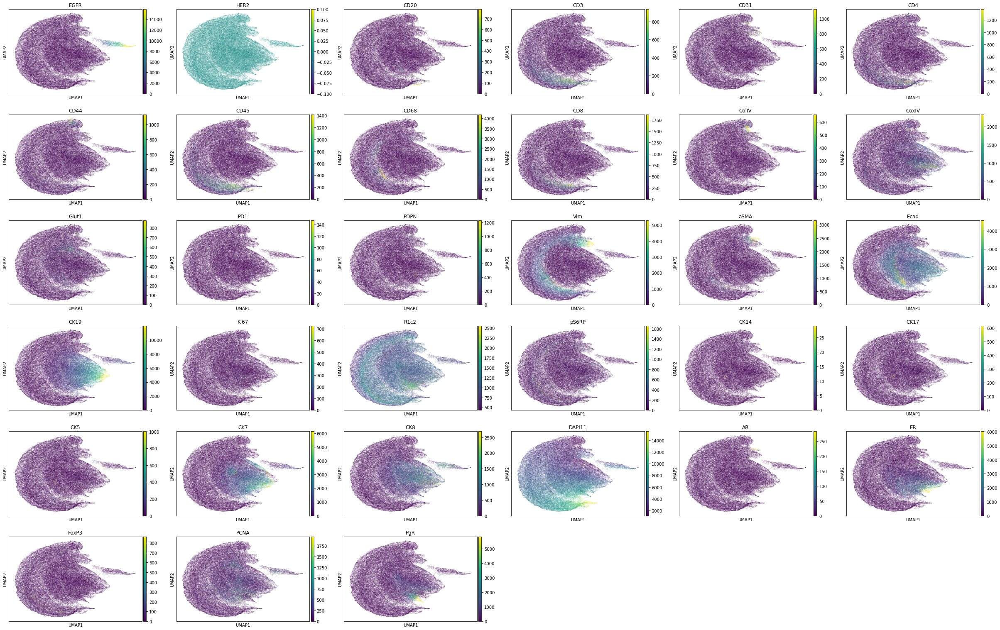

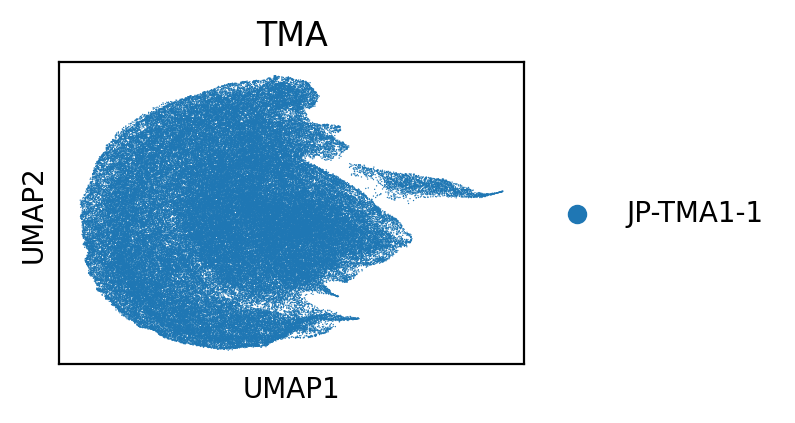

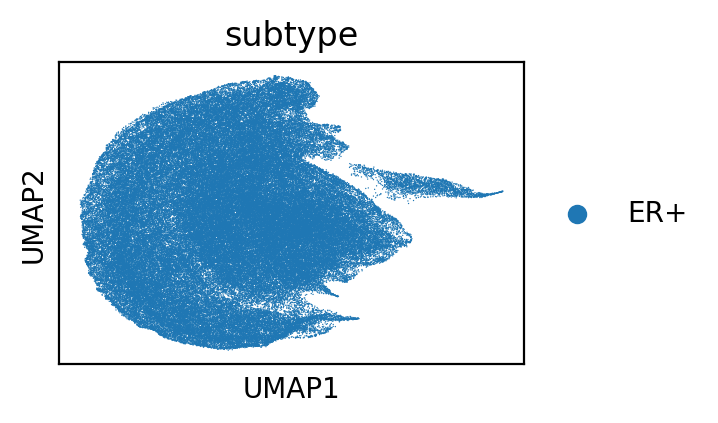

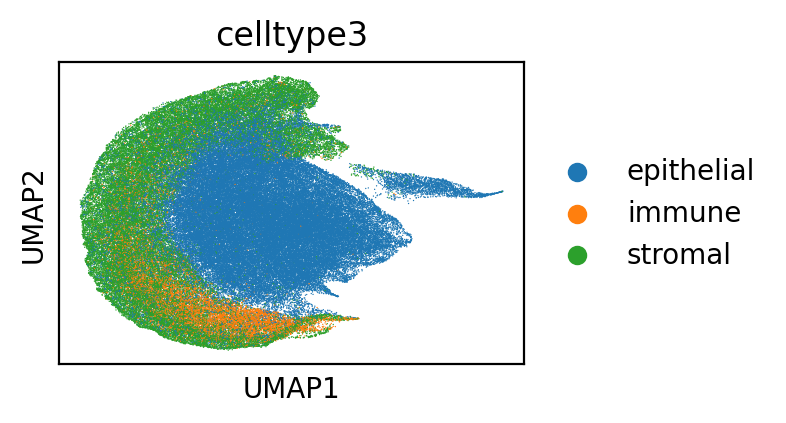

In [532]:
#just one subtype
s_subtype = 'ER+' #TNBC
adata1 = sc.AnnData(df_norm.loc[((df_norm.subtype == s_subtype) & (df_norm.DAPI12pos) & (~df_norm.index.isin(df_exclude.index))),ls_col])
n_neighbors = 30
results_file = f'20211207_JP-TMA1_{n_neighbors}neighbors_{len(ls_col)}markers{s_subtype}.h5ad'  
if not os.path.exists(results_file):
    print('calc umap')
    # calculate neighbors 
    sc.pp.neighbors(adata1, n_neighbors=n_neighbors) #, method='rapids'
    sc.tl.umap(adata1)
    adata1.obs['TMA'] = [item.split('_')[0] for item in adata1.obs.index]
    adata1.obs['slide_scene'] = [item.split('_cell')[0] for item in adata1.obs.index]
    adata1.obs['subtype'] = adata1.obs.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)
    adata1.obs['celltype3'] = df_man.loc[adata1.obs.index,'celltype3']
    adata1.write(results_file)
else:
    print('loading umap')
    adata1 = sc.read_h5ad(results_file)
    adata1.obs['TMA'] = [item.split('_')[0] for item in adata1.obs.index]
    adata1.obs['slide_scene'] = [item.split('_cell')[0] for item in adata1.obs.index]
    adata1.obs['subtype'] = adata1.obs.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)
    adata1.obs['celltype3'] = df_man.loc[adata1.obs.index,'celltype3']
#color by markers
figname = f"Umap_markers_{n_neighbors}neighbors_{len(ls_col)}markers_{s_subtype}.png"
sc.pl.umap(adata1, color=ls_col,vmin='p1.5',vmax='p99.8',save=figname,ncols=6)
#color by TMA
figname = f"Umap_TMA_{n_neighbors}neighbors_{len(ls_col)}markers_{s_subtype}.png"
fig,ax = plt.subplots(figsize=(3,2), dpi=200)
sc.pl.umap(adata1, color='TMA',wspace=.25,save=figname,ax=ax)

figname = f"Umap_subtype_{n_neighbors}neighbors_{len(ls_col)}markers_{s_subtype}.png"
fig,ax = plt.subplots(figsize=(3,2), dpi=200)
sc.pl.umap(adata1, color='subtype',wspace=.25,save=figname,ax=ax)

figname = f"Umap_celltype3_{n_neighbors}neighbors_{len(ls_col)}markers_{s_subtype}.png"
fig,ax = plt.subplots(figsize=(3,2), dpi=200)
sc.pl.umap(adata1, color='celltype3',wspace=.25,save=figname,ax=ax)

In [193]:
len(adata1)

131811

##  Cluster Leiden <a name="l8"></a>

cluster umap projection of single cells


[contents](#contents)

In [181]:
results_file
#'20211207_JP-TMA1_15neighbors_40markers.h5ad'

'20211207_JP-TMA1_15neighbors_34markersER+.h5ad'

loading leiden


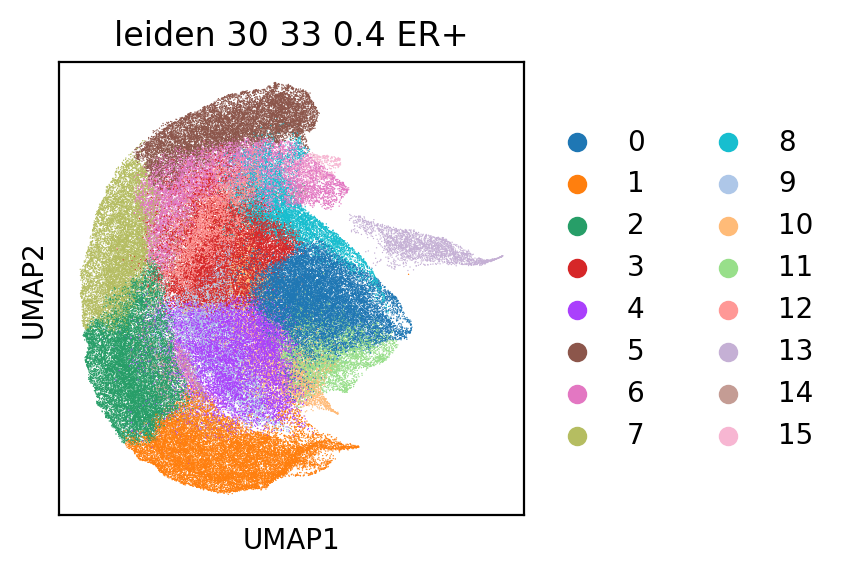

In [511]:
#leiden

s_sample = '20211207_JP-TMA1'
n_neighbors = 30 #16
n_markers = 33 #32 # 34 #32 #40 #34
s_type = 'ER+' #''#
adata = sc.read_h5ad(f'{s_sample}_{n_neighbors}neighbors_{n_markers}markers{s_type}.h5ad')
resolution = 0.4
results_file = f'{s_sample}_{n_neighbors}neighbors_{n_markers}markers_{s_type}_leiden{resolution}.h5ad'
if not os.path.exists(results_file):
    print('clustering')
    sc.tl.leiden(adata,resolution=resolution)
    adata.write(results_file)
else:
    print('loading leiden')
    adata = sc.read_h5ad(results_file)

fig,ax = plt.subplots(figsize=(3,3),dpi=200)
figname=f'leiden_{n_neighbors}_{n_markers}_{resolution}_{s_type}.png'
sc.pl.umap(adata, color='leiden',ax=ax,save=figname,title=figname.split('.png')[0].replace('_',' '))


In [446]:
if resolution == 0.8:
    print('annotating')
    ls_merge = ['17', '12', '14','20','10','4']
    adata[adata.obs.leiden.isin(ls_merge)].to_df().to_csv('annotated_JP-TMA1-1_unmarked_stroma.csv')

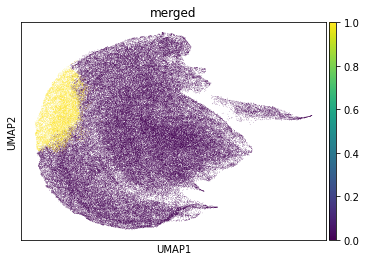

In [512]:
ls_merge = [ '6', '23',  '9', '5','10','11','8'] #'12',
ls_merge = ['17', '12', '14','20','10','4']
ls_merge=['7'] #,'9','2','1'
adata.obs['test'] = (adata.obs.leiden.isin(ls_merge)).replace({True:1,False:0})
sc.pl.umap(adata, color='test',title='merged')

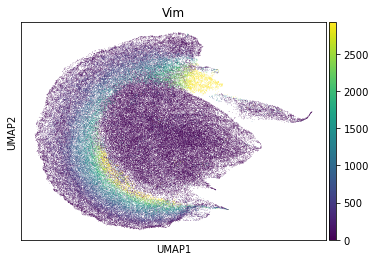

In [378]:
sc.pl.umap(adata, color='Vim',vmin='p1.5',vmax='p98.5')

## Annotate Leiden <a name="lbar"></a>

annotate epitelial, immune a stroma cell types

also visualize cluster results on tissue scatter plots. Additional visualization done using 20201018_JP-TMAs_napari.py,
to visualize ome.tiff created in 20201005_JP-TMA_Pipeline.py


[contents](#contents)

In [513]:
#load leiden
resolution = 0.4
s_sample = '20211207_JP-TMA1'
n_neighbors = 30 #16
n_markers = 33 #32 #32 #40 #34
s_type = 'ER+' #''#
results_file = f'{s_sample}_{n_neighbors}neighbors_{n_markers}markers_{s_type}_leiden{resolution}.h5ad'
adata = sc.read_h5ad(results_file)

In [514]:
#unmarked stroma
df_str = pd.read_csv(f'annotated_JP-TMA1-1_unmarked_stroma.csv',index_col=0)

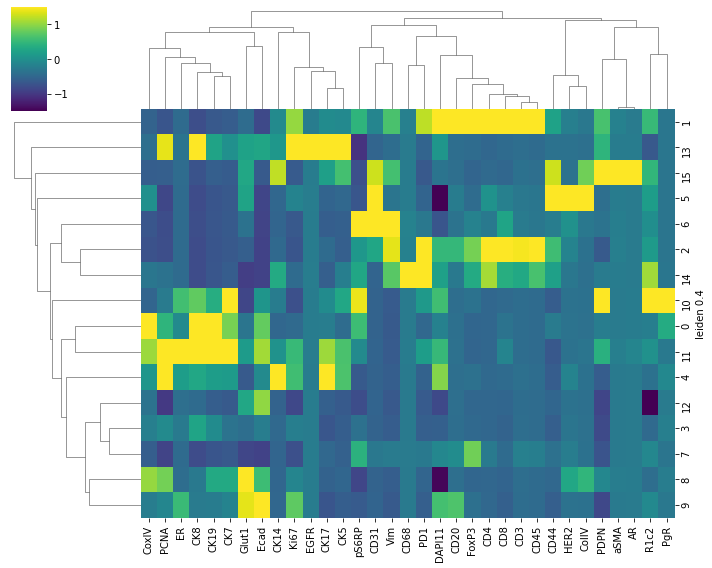

In [526]:
#clustermap
b_annot = False
#df_p = pd.DataFrame(data=adata.X,index=adata.obs.index,columns=adata.var.index)
df_p = adata.to_df()
df_p['leiden'] = adata.obs['leiden']
#ls_merge = ['40', '15', '30', '8', '23', '3', '7', '19', '35', '27', '36', '38', '28', '32', '21', '31', '26', '22', '39']
#ls_merge = [ '6', '23', '12', '9', '5','10']
#ls_merge = ['17', '12', '14','20','10','4']
#df_p.loc[df_p.leiden.isin(ls_merge),'leiden'] = '20'
if n_markers == 34:
    df_p.loc[df_p.index.isin(df_str.index),'leiden'] = '7'
if n_markers == 32:
    df_p.loc[df_p.index.isin(df_str.index),'leiden'] = '6'
if n_markers == 33:
    df_p.loc[df_p.index.isin(df_str.index),'leiden'] = '7'
d_replace = {}
if b_annot:
    d_replace.update(dict(zip(tum_clust,[f'{item}\nep' for item in tum_clust])))
    d_replace.update(dict(zip(imm_clust,[f'{item}\nim' for item in imm_clust])))
    d_replace.update(dict(zip(str_clust,[f'{item}\ns' for item in str_clust])))
    d_replace.update(dict(zip(endo_clust,[f'{item}\nen' for item in endo_clust])))
    df_plot = df_p.loc[:,(df_p.dtypes=='float32') | (df_p.columns=='leiden')].groupby('leiden').mean().fillna(0).rename(d_replace)
else:
    df_plot = df_p.loc[:,(df_p.dtypes=='float32') | (df_p.columns=='leiden')].groupby('leiden').mean().dropna()#.fillna(0)
df_plot.index.name = f'leiden {resolution}'
df_plot = df_plot.loc[:,df_plot.sum() > 0]
g = sns.clustermap(df_plot,z_score=1,figsize=(10,8),cmap='viridis',
                   vmin=-1.5,vmax=1.5)
g.savefig(f'{codedir}/{s_date}/{s_sample}_clustermap_{n_neighbors}_{n_markers}markers_{s_type}_leiden{resolution}.png',dpi=200)
marker_genes = df_plot.iloc[:,g.dendrogram_col.reordered_ind].columns.tolist()
categories_order = df_plot.iloc[g.dendrogram_row.reordered_ind,:].index.tolist()

In [516]:
adata.obs['leiden'] = df_p.leiden

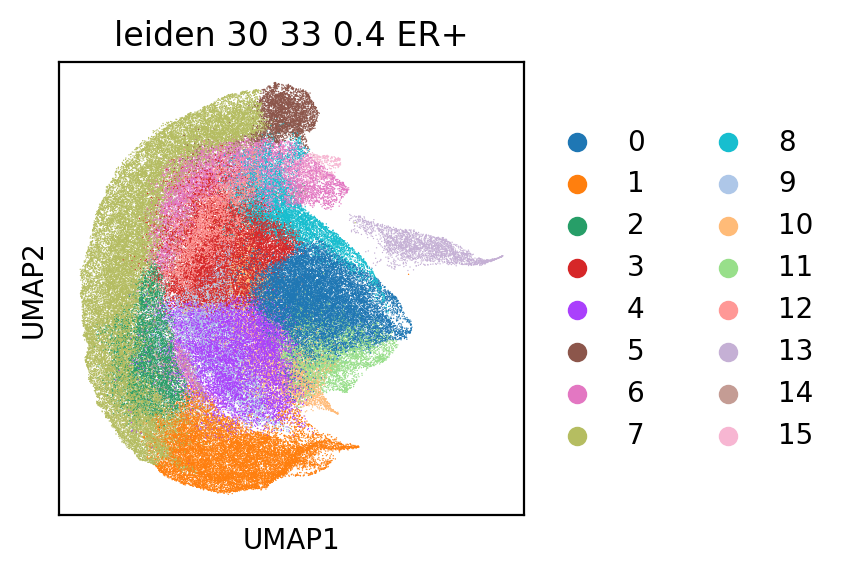

In [517]:
fig,ax = plt.subplots(figsize=(3,3),dpi=200)
figname=f'leiden_{n_neighbors}_{n_markers}_{resolution}_{s_type}.png'
sc.pl.umap(adata, color='leiden',ax=ax,save=figname,title=figname.split('.png')[0].replace('_',' '))

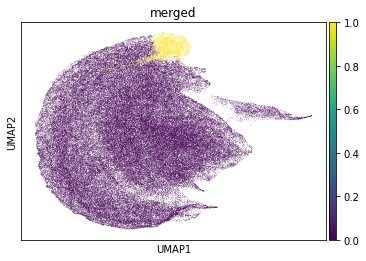

In [518]:
ls_merge=['5'] #,'9','2','1'
adata.obs['test'] = (adata.obs.leiden.isin(ls_merge)).replace({True:1,False:0})
sc.pl.umap(adata, color='test',title='merged')

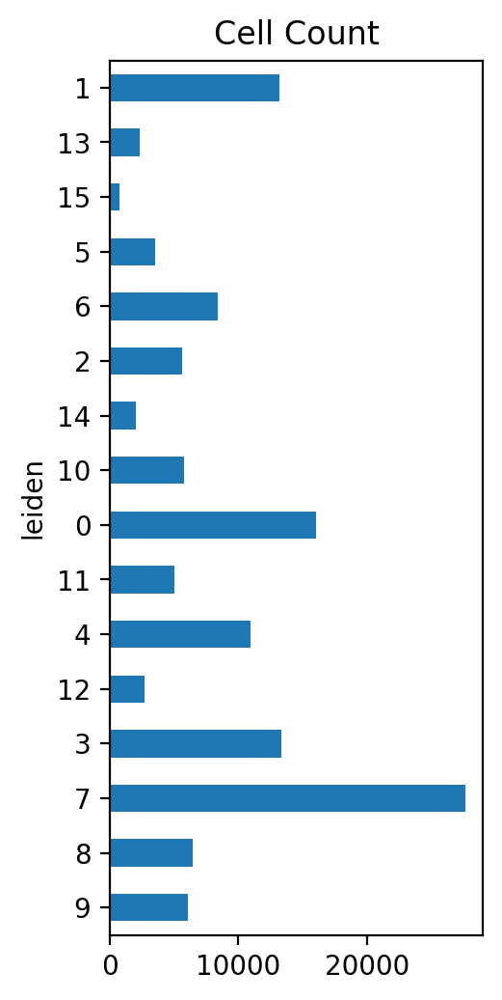

In [519]:
fig,ax=plt.subplots(figsize=(2.5,6),dpi=200)
df_p.groupby('leiden').count().loc[categories_order[::-1]].iloc[:,1].plot(kind='barh',title='Cell Count',ax=ax)
fig.savefig(f'{codedir}/{s_date}/barplot_{s_sample}_{n_neighbors}neighbors_{len(marker_genes)}markers_leiden{resolution}_{s_type}.png')

In [521]:
#df_p[df_p.leiden=='20'].to_csv('exclude_JP-TMA-1_ER+_34markers_leiden0.6_20.csv')
#df_p.to_csv(f'20211207_JP-TMA1_LeidenClustering_neighbors{n_neighbors}_resolution{resolution}_markers{n_markers}_{s_type}.csv')

In [647]:
results_file

'20211207_JP-TMA1_30neighbors_33markersER+.h5ad'

In [520]:
#ER+ leiden 0.6 notes 34 markers
#look for artifact: REMOVE: 20
#20 scene35 - most of this tissue is faint AF in EGFR,HER2,PDPN. take out 20, but sacrifice scene 35
#20 scene 108 most of tumor lost, maybe analysis @ an ealier round would be better?, looks like R1c1 AF
#21 looks like a patch of smooth muscle in 42, myoepithelial in 98
#15 is endothelial
#24 are immune CD20, out of focus. Could merge with 5
#19 is tumor with PD1 bright dots: need to exclude cells with extremely high PD1 (scene007 and 073)
#10 grnzb in a few cells. could merge with 1 and 23. take out grnzb from clustering
# 8 small cells because of unfocesed DAPI in scene 32. remove area? 
#22 is very PgR bright.
#23 is tumor, segmentation not great - lots of eccentricity. can't trust morphology much in some of these cores
#plan: recluster: take out PD1, GRNZ, area, eccentricity, DAPI11 cluster 20 

#ER+ 32 markers leiden 0.6 notes
# 17 is real, take out R1 c2
#don't understand 12. HER2 driven?? filter outliers HER2 q=.99999
#filter ouliters PD1: real PD1 is maximum 800-maybe 1300,use q=.9993.  artifact is 1600+
#28 Ki67 ... weird


s_clust = '5'
df_p['slide_scene'] = [item.split('_cell')[0] for item in df_p.index]
df_p.groupby(['leiden','slide_scene']).count().loc[s_clust].iloc[:,1].sort_values(ascending=False)

slide_scene
JP-TMA1-1_scene032    1358
JP-TMA1-1_scene099    1082
JP-TMA1-1_scene071     142
JP-TMA1-1_scene020      67
JP-TMA1-1_scene037      61
JP-TMA1-1_scene031      58
JP-TMA1-1_scene054      57
JP-TMA1-1_scene085      54
JP-TMA1-1_scene005      53
JP-TMA1-1_scene081      39
JP-TMA1-1_scene110      35
JP-TMA1-1_scene078      33
JP-TMA1-1_scene048      33
JP-TMA1-1_scene019      27
JP-TMA1-1_scene046      25
JP-TMA1-1_scene088      24
JP-TMA1-1_scene087      20
JP-TMA1-1_scene119      20
JP-TMA1-1_scene098      20
JP-TMA1-1_scene106      20
JP-TMA1-1_scene024      20
JP-TMA1-1_scene025      19
JP-TMA1-1_scene049      19
JP-TMA1-1_scene045      18
JP-TMA1-1_scene007      18
JP-TMA1-1_scene016      16
JP-TMA1-1_scene027      16
JP-TMA1-1_scene022      15
JP-TMA1-1_scene053      14
JP-TMA1-1_scene109      13
JP-TMA1-1_scene069      13
JP-TMA1-1_scene073      10
JP-TMA1-1_scene094       9
JP-TMA1-1_scene118       8
JP-TMA1-1_scene092       8
JP-TMA1-1_scene112       8
JP-TMA1-1_scene0

In [293]:
s_marker = 'HER2'#'PD1'#'Ki67'#'CK19'#'GRNZB'#'GRNZB' #
df_norm[df_norm.loc[:,s_marker] > np.quantile(df_norm.loc[:,s_marker],q=.99999)].loc[:,s_marker].sort_values()

JP-TMA1-1_scene038_cell3327    4415.010638
JP-TMA1-1_scene080_cell1795    4429.316456
JP-TMA1-1_scene038_cell574     4698.022989
JP-TMA1-1_scene009_cell5642    5287.168142
JP-TMA1-1_scene038_cell3278    5405.930233
JP-TMA1-1_scene092_cell4080    6923.477273
Name: HER2, dtype: float64

In [189]:
#plot all groups spatially - leiden 
colors = mpl.cm.tab20b.colors + mpl.cm.tab20c.colors

df_pos = analyze.celltype_to_bool(df_p,'leiden')
df_pos.columns = [str(item) for item in df_pos.columns]


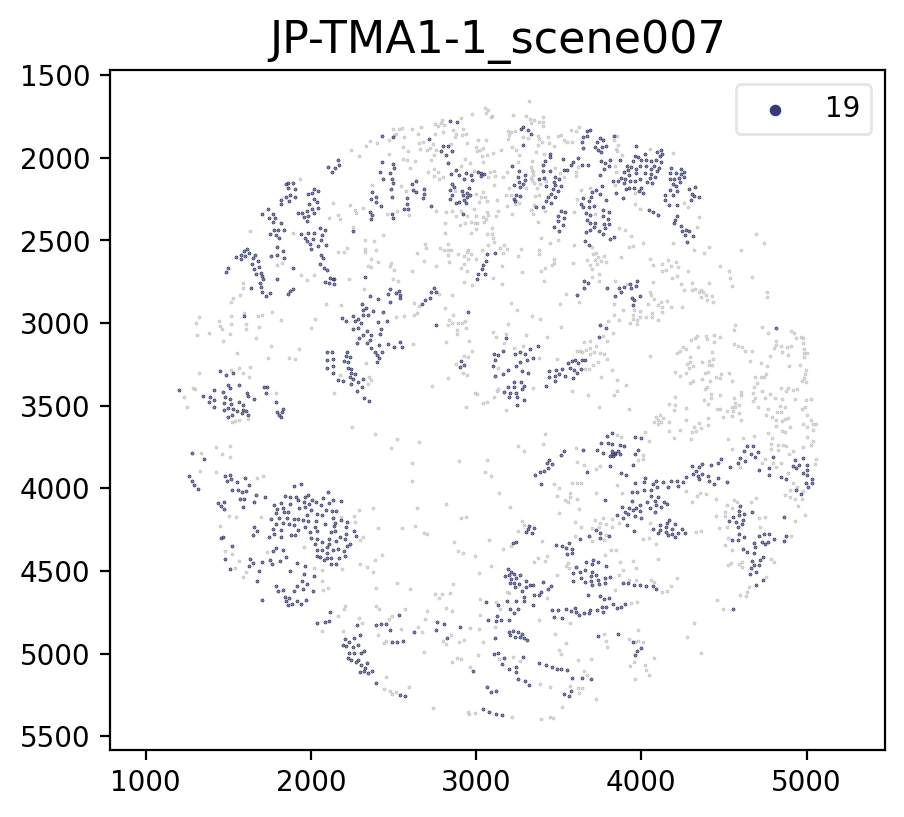

In [201]:

for s_slide in sorted(set(df_p.slide_scene)):
    s_slide = 'JP-TMA1-1_scene007'
    fig,ax = plt.subplots(figsize=(5,4.5),dpi=200)
    #plot negative cells
    df_scene = df_data[df_data.index.str.contains(s_slide)]
    ax.scatter(data=df_scene,x='DAPI_X',y='DAPI_Y',color='silver',s=0.1,label=f'')
    #for idxs, s_color_int in enumerate(range(len(df_pos.columns))):
    for idxs, s_color in enumerate(df_pos.columns):
        s_color = s_clust
        s_color = str(s_color)
        if len(df_p[(df_p.slide_scene==s_slide) & (df_pos.loc[:,s_color])])>=1:
            #plot positive cells
            ls_index = df_p[(df_p.slide_scene==s_slide) & (df_pos.loc[:,s_color])].index
            ax.scatter(data=df_data.loc[ls_index],x='DAPI_X',y='DAPI_Y',label=f'{s_color}',s=0.1,color=colors[idxs])
        break
    ax.set_title(f"{s_slide}", fontsize=16) # \n {d_a[s_slide]}
    ax.axis('equal')
    ax.set_ylim(ax.get_ylim()[::-1])
    #ax.set_xticklabels('')
    #ax.set_yticklabels('')
    #break
    plt.legend(markerscale=10,framealpha=.5) 
    #fig.savefig(f'{codedir}/{s_date}/{s_slide}_leiden{resolution}_scatterplot.png')
    break

In [107]:
len(df_p.slide_scene.unique())

50

In [64]:
#CD45 above 640
#CKS above 1024
# CD68 above 1536
#area above 318
#all 30 neigh, 7 pcs

if resolution == 0.6:
    tum_clust = ['23', '17', '8', '19', '21','28','14', '20', '22',  '25', '12', '6', '7','24', '16','18'] #18?
    str_clust = ['0',  '11', '13', '15', '2',  '27', '3']
    imm_clust = ['5', '4', '10', '9', '26','1'] #1 is macrophage
    endo_clust = ['11','13']

df_p.groupby('leiden').mean().Ecad.sort_values(ascending=False)#.index
set(df_p.groupby('leiden').mean().area.sort_values(ascending=False).index) - set(tum_clust + imm_clust )
#set(tum_clust)

{'0', '11', '13', '15', '2', '27', '3'}

In [65]:
df_p.loc[df_p.leiden.isin(tum_clust),'celltype'] = 'epithelial'
df_p.loc[df_p.leiden.isin(str_clust),'celltype'] = 'stromal'
df_p.loc[df_p.leiden.isin(imm_clust),'celltype'] = 'immune'

In [ ]:
adata.obs['celltype'] = df_p.celltype
fig,ax = plt.subplots(figsize=(3,2),dpi=200)
figname=f'leiden_{n_neighbors}_{n_markers}_{resolution}_{s_type}_celltype.png'
sc.pl.umap(adata, color='celltype',ax=ax,save=figname,title=figname.split('.png')[0].replace('_',' '))

In [69]:
#save
s_out = f'results_{s_sample}_{n_neighbors}_{n_markers}_{s_type}_leiden{resolution}.csv'
if not os.path.exists(s_out):
    print('saving csv')
    df_p.to_csv(s_out)

saving csv


## Summarize Tissue Variables <a name="tissue"></a>

per patient means


[contents](#contents)

In [593]:
#load gated
s_coloc = '20211207_JP-TMA1_GatedCellTypes_M1M2.csv'
df_data = pd.read_csv(f'{codedir}/data/{s_coloc}',index_col=0)
df_norm = pd.read_csv('20211207_JP-TMA1_BGSubtractedMeanIntensity.csv',index_col=0)

df_data['celltype3'] = df_data.celltype.replace({'tumor':'epithelial','endothelial':'stromal'})
df_data['celltype2'] = df_data.celltype.replace({'tumor':'epithelial','endothelial':'stromal','immune':'stromal'})

df_norm['celltype1'] = 'all'
df_norm.loc[df_data.celltype.index,'celltype3'] = df_data.celltype3
df_norm.loc[df_data.celltype.index,'celltype2'] = df_data.celltype2

df_exclude = pd.read_csv('exclude_JP-TMA-1_ER+_34markers_leiden0.6_20_HER2_PD1_AF.csv',index_col=0)
df_norm['subtype'] = df_norm.slide_scene.map(d_cyc_sub).fillna('other').replace(d_replace)
df_norm['Patient'] = df_norm.slide_scene.map(dict(zip(df_annot.index,df_annot.Accession)))
df_data['Patient'] = df_data.slide_scene.map(dict(zip(df_annot.index,df_annot.Accession)))

In [583]:
#just ER+
s_subtype = 'ER+' #'TNBC'#
if s_subtype == '':
    df_norm_sub = df_norm[(~df_norm.index.isin(df_exclude.index)) & (df_norm.DAPI12pos)]
else:
    df_norm_sub = df_norm[(df_norm.subtype==s_subtype) & (~df_norm.index.isin(df_exclude.index)) & (df_norm.DAPI12pos)]
df_data_sub = df_data.loc[df_norm_sub.index]

In [645]:
#gated celltypes (fraction)
s_grouper='Patient'
ls_cell = df_data.columns[df_data.dtypes=='object'].drop(['Patient','slide','slide_scene'])
for s_cell in ls_cell:
    df_prop = viz.prop_positive(df_data_sub,s_cell=s_cell,s_grouper=s_grouper)
    s_out = f'results_20211207_JP-TMA1_GatedCellTypes_M1M2_by{s_grouper}_by{s_cell}_{s_subtype}.csv'
    df_prop.to_csv(s_out)

In [646]:
#marker expression in tumor, stroma
for s_celltype in ['celltype1','celltype2','celltype3']:
    df_multi = df_norm_sub.loc[:,(df_norm_sub.dtypes=='float64') | (df_norm_sub.columns.isin(['Patient',s_celltype]))].groupby(['Patient',s_celltype]).mean()
    for s_cell in df_norm_sub.loc[:,s_celltype].unique():
        df = df_multi.loc[pd.IndexSlice[:, s_cell], :]
        df = df.reset_index().drop([s_celltype,'DAPI_X','DAPI_Y'],axis=1).set_index('Patient')
        s_out = f'results_20211207_JP-TMA1_BGSubtractedMeanIntensity_byPatient_by{s_celltype}_in{s_cell}_{s_subtype}.csv'
        df.to_csv(s_out)

In [652]:
#leiden cell types (fraction)
n_neighbors=30
resolution=0.4
n_markers=33
s_type='ER+'
df_lei = pd.read_csv(f'20211207_JP-TMA1_LeidenClustering_neighbors{n_neighbors}_resolution{resolution}_markers{n_markers}_{s_type}.csv',index_col=0)
df_lei['Patient'] = df_lei.slide_scene.map(dict(zip(df_annot.index,df_annot.Accession)))
df_lei['countme'] = True

In [658]:
df_prop = viz.prop_positive(df_lei,s_cell='leiden',s_grouper='Patient')
s_out = f'results_20211207_JP-TMA1_LeidenClustering_neighbors{n_neighbors}_resolution{resolution}_markers{n_markers}_byPatient_{s_type}.csv'
df_prop.fillna(0).to_csv(s_out)

## survival analysis <a name="surv"></a>


- single variable

- subtypes

[contents](#contents)


In [ ]:
pwd

In [ ]:
ls_result = ['results_20211207_JP-TMA1_BGSubtractedMeanIntensity_byPatient_bycelltype3_inimmune_TNBC.csv',
             'results_20211207_JP-TMA1_GatedCellTypes_M1M2_byPatient_bycelltype_TNBC.csv',
             'results_20211207_JP-TMA1_LeidenClustering_neighbors30_resolution0.4_markers33_byPatient_ER+.csv']